Base repo of data: https://github.com/mlsedigital/SPL-open-data

Great xyz data dict: https://www.inpredictable.com/2021/01/nba-player-shooting-motions-data-dump.html


## Ultimate Goals:
* Find optimal shooting form/release point
  * Include the feedback system based on optimal shooting form and release point
  * ### Use shooting meter from NBA 2k to show good vs bad releases and body movements
  * ^use the motions that:
    * produce good results (a make or enough kinetic energy for a near make)
    * are within certain boundaries where the player is comfortable AND in right shooting form
    * are within certain ranges (this inch to this inch is the best motion area for this player, etc.)
    * Compared to Popular Shooters to make recommendations to shoot more like someone like Klay Thompson or Buddy Hield (see if the data from the xyz data dictionary has good shooters to make recommendations to shoot like them)
* Exhaustion levels and optimal energy max and min
* Shot outcome prediction


1. Finding Optimal Shooting Form/Release Point

    Detailed Analysis of Body Movements: Include analysis of body kinematics (positions and velocities of limbs) at the time of release. Use joint coordinates to extract features like elbow angle, shoulder rotation, and wrist flexion at the release frame.
    Machine Learning for Form Classification: Train a model to classify "good" vs. "bad" shooting forms using successful shot data (makes or near-makes) and compare them against unsuccessful shots.
    Feedback Mechanism: Implement a feedback system that suggests adjustments based on the comparison of current shooting mechanics to historical optimal ones.

2. Shooting Meter Simulation (NBA 2K-Style)

    Visual Feedback System: Develop a visualization tool that overlays a “meter” on shot video frames, indicating the quality of the release in real-time. This can be based on a scoring function derived from the shooting form features and ball dynamics.
    Comfort Zone Identification: Use clustering algorithms (e.g., K-means) to identify comfortable ranges of motion based on historical shooting data for individual players.

3. Shot Outcome Prediction

    Feature Engineering for Outcome Modeling: Include additional features such as:
        Kinetic Energy Calculation: KE=12mv2KE=21​mv2 to see if the ball had sufficient energy for a make.
        Entry Angle and Trajectory Analysis: Analyze whether the angle at which the ball approaches the hoop aligns with optimal scoring trajectories.
    Model Development: Build a machine learning model (e.g., logistic regression, XGBoost) that predicts shot outcomes based on ball speed, entry angle, release point, and body dynamics.
    Training with Data Augmentation: Use synthetic data generation to include a wide variety of shot scenarios.

4. Exhaustion Levels and Energy Management

    Tracking Player Movements: Use the coordinates of major joints (e.g., knees, hips) to estimate a player's exertion level using metrics like the average vertical displacement over time.
    Velocity and Acceleration Patterns: Monitor changes in the velocity and acceleration of the player's body parts throughout a game to detect fatigue.
    Feature Integration: Create features such as average speed and distance covered leading up to the shot to include in the predictive model.

5. shot simulator: 
    if by these metrics we can simulate the shot to a nearby hoop. We can set the hoop in a set location (or when using spatial, we'd pick the location), and set it up to virtualize the experience with yolo/opencv where when you make those motions to show shooting motion, you can show where the ball might go (even without a ball in hand).

In [1]:
# %%writefile ../../src/animation_dataframe_addons.py

import logging
import pandas as pd
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.patches as patches
from mplbasketball.court3d import Court3D, draw_court_3d
import inspect

# Configure logging for debugging
logging.basicConfig(level=logging.DEBUG, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# Define the connections between joints
connections = [
    # Define the skeletal connections between body parts for visualization
    ("R_EYE", "L_EYE"), ("R_EYE", "NOSE"), ("L_EYE", "NOSE"),
    ("R_EYE", "R_EAR"), ("L_EYE", "L_EAR"), ("R_SHOULDER", "L_SHOULDER"),
    ("R_SHOULDER", "R_ELBOW"), ("L_SHOULDER", "L_ELBOW"), ("R_ELBOW", "R_WRIST"),
    ("L_ELBOW", "L_WRIST"), ("R_SHOULDER", "R_HIP"), ("L_SHOULDER", "L_HIP"),
    ("R_HIP", "L_HIP"), ("R_HIP", "R_KNEE"), ("L_HIP", "L_KNEE"),
    ("R_KNEE", "R_ANKLE"), ("L_KNEE", "L_ANKLE"), ("R_WRIST", "R_1STFINGER"),
    ("R_WRIST", "R_5THFINGER"), ("L_WRIST", "L_1STFINGER"), ("L_WRIST", "L_5THFINGER"),
    ("R_ANKLE", "R_1STTOE"), ("R_ANKLE", "R_5THTOE"), ("L_ANKLE", "L_1STTOE"),
    ("L_ANKLE", "L_5THTOE"), ("R_ANKLE", "R_CALC"), ("L_ANKLE", "L_CALC"),
    ("R_1STTOE", "R_5THTOE"), ("L_1STTOE", "L_5THTOE"), ("R_1STTOE", "R_CALC"),
    ("L_1STTOE", "L_CALC"), ("R_5THTOE", "R_CALC"), ("L_5THTOE", "L_CALC"),
    ("R_1STFINGER", "R_5THFINGER"), ("L_1STFINGER", "L_5THFINGER")
]

def initialize_plot(zlim, elev, azim, debug=False):
    """
    Initialize a 3D plot with specified view settings and outputs setup details.

    Parameters:
    - zlim (float): The limit for the z-axis (height).
    - elev (float): Elevation angle in the z plane for the camera view.
    - azim (float): Azimuth angle in the x,y plane for the camera view.
    - debug (bool): Flag to enable debug logging.

    Returns:
    - fig: The Matplotlib figure object.
    - ax: The Matplotlib 3D axis object.
    """
    try:
        fig = plt.figure(figsize=(10, 8))
        ax = fig.add_subplot(111, projection="3d")
        ax.set_zlim([0, zlim])
        ax.set_box_aspect([1, 1, 1])
        ax.view_init(elev=elev, azim=azim)
        ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
        ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_zticks([])
        if debug:
            logger.debug(f"Initialized 3D plot with Z limit: {zlim}, Elevation: {elev}, Azimuth: {azim}")
        return fig, ax
    except Exception as e:
        logger.error(f"Failed to initialize plot: {e}")
        raise

def get_hoop_position(court_type="nba", units="ft", debug=False):
    """
    Calculate the 3D position of the basketball hoop based on court specifications.

    Parameters:
    - court_type (str): Type of the court ('nba', 'wnba', 'ncaa').
    - units (str): Units of measurement ('ft' or 'm').
    - debug (bool): Flag to enable debug logging.

    Returns:
    - x, y, z (float): Coordinates of the hoop in 3D space.
    """
    try:
        court = Court3D(court_type=court_type, units=units)
        params = court.court_parameters
        # The hoop is located a certain distance from the edge of the court
        x = params['court_dims'][0] / 2 - params['hoop_distance_from_edge']
        y = 0.0  # Centered along the y-axis
        z = params['hoop_height']
        if debug:
            logger.debug(f"Calculated hoop position at (x={x}, y={y}, z={z}) for court type '{court_type}' in '{units}' units.")
        return x, y, z
    except KeyError as e:
        logger.error(f"Key error when accessing court parameters: {e}")
        raise
    except Exception as e:
        logger.error(f"Unexpected error in get_hoop_position: {e}")
        raise

def draw_court(ax, court_type="nba", units="ft", debug=False):
    """
    Draw the basketball court and hoop on the given axes.

    Parameters:
    - ax: The Matplotlib 3D axis object.
    - court_type (str): Type of the court ('nba', 'wnba', 'ncaa').
    - units (str): Units of measurement ('ft' or 'm').
    - debug (bool): Flag to enable debug logging.

    Returns:
    - None
    """
    try:
        # Draw the court using mplbasketball
        draw_court_3d(ax, court_type=court_type, units=units, origin=np.array([0.0, 0.0]), line_width=2)
        if debug:
            logger.debug("Court drawn successfully.")

        # Get hoop position
        hoop_x, hoop_y, hoop_z = get_hoop_position(court_type=court_type, units=units, debug=debug)

        # Draw the hoop as a circle
        hoop_radius = Court3D(court_type=court_type, units=units).court_parameters['hoop_diameter'] / 2
        theta = np.linspace(0, 2 * np.pi, 100)
        hoop_xs = hoop_x + hoop_radius * np.cos(theta)
        hoop_ys = hoop_y + hoop_radius * np.sin(theta)
        hoop_zs = np.full_like(hoop_xs, hoop_z)

        ax.plot(hoop_xs, hoop_ys, hoop_zs, c='orange', lw=3)
        if debug:
            logger.debug(f"Hoop drawn at position ({hoop_x}, {hoop_y}, {hoop_z}) with radius {hoop_radius}.")
    except Exception as e:
        logger.error(f"Error drawing court or hoop: {e}")
        raise

def initialize_elements(ax, connections, player_color, player_lw, ball_color, ball_size, debug=False):
    """
    Initialize plot elements such as lines for the player skeleton and the ball.

    Parameters:
    - ax: The Matplotlib 3D axis object.
    - connections (list): List of tuples defining body part connections.
    - player_color (str): Color of the player's skeleton lines.
    - player_lw (float): Line width of the player's skeleton.
    - ball_color (str): Color of the ball.
    - ball_size (float): Size of the ball marker.
    - debug (bool): Flag to enable debug logging.

    Returns:
    - lines (dict): Dictionary of line objects for each connection.
    - ball: The ball plot object.
    - release_text: Text object for release point indicator.
    - motion_text: Text object for motion phase indicator.
    """
    try:
        # Initialize lines for each body connection
        lines = {connection: ax.plot([], [], [], c=player_color, lw=player_lw)[0] for connection in connections}
        # Initialize the ball as a point
        ball, = ax.plot([], [], [], "o", markersize=ball_size, c=ball_color)
        # Text elements for annotations
        release_text = ax.text2D(0.05, 0.95, "", transform=ax.transAxes, color="red", fontsize=14, weight="bold")
        motion_text = ax.text2D(0.05, 0.90, "", transform=ax.transAxes, color="blue", fontsize=12, weight="bold")
        if debug:
            logger.debug("Elements initialized (lines, ball, text labels).")
        return lines, ball, release_text, motion_text
    except Exception as e:
        logger.error(f"Error initializing elements: {e}")
        raise

def update_frame(ax, frame, df, release_frame, lines, ball, release_text, motion_text,
                 connections, xbuffer, ybuffer, ball_color, highlight_color, debug=False):
    """
    Update function for each frame in the animation.

    Parameters:
    - ax: The Matplotlib 3D axis object.
    - frame (int): The current frame number.
    - df (DataFrame): DataFrame containing motion data.
    - release_frame (int): Frame index of the release point.
    - lines (dict): Dictionary of line objects for skeleton.
    - ball: Ball object for animation.
    - release_text: Text object for release point.
    - motion_text: Text object for motion phase.
    - connections (list): Joint connections.
    - xbuffer (float): Horizontal axis buffer (not used in fixed axes mode).
    - ybuffer (float): Vertical axis buffer (not used in fixed axes mode).
    - ball_color (str): Default ball color.
    - highlight_color (str): Highlight color for release point.
    - debug (bool): Flag to enable debug logging.

    Returns:
    - None
    """
    try:
        if debug and frame % 10 == 0:
            logger.debug(f"Updating frame {frame}")

        # Highlight the release frame
        if frame == release_frame:
            ball.set_color(highlight_color)
            release_text.set_text("Release Point!")
            if debug:
                logger.debug(f"Frame {frame} is the release frame. Ball color changed to {highlight_color}.")
        else:
            ball.set_color(ball_color)
            release_text.set_text("")

        # Update motion phase text
        motion_text.set_text("Shooting Motion" if df.loc[frame, 'shooting_motion'] == 1 else "")

        # **Note**: We are not adjusting axes limits here because we have fixed them to include both player and hoop

        # Update lines for joints
        for connection in connections:
            part1, part2 = connection
            if f"{part1}_x" in df.columns and f"{part2}_x" in df.columns:
                x = [df.loc[frame, f"{part1}_x"], df.loc[frame, f"{part2}_x"]]
                y = [df.loc[frame, f"{part1}_y"], df.loc[frame, f"{part2}_y"]]
                z = [df.loc[frame, f"{part1}_z"], df.loc[frame, f"{part2}_z"]]
                lines[connection].set_data_3d(x, y, z)

        # Update ball position
        ball.set_data_3d([df.loc[frame, 'ball_x']], [df.loc[frame, 'ball_y']], [df.loc[frame, 'ball_z']])
    except Exception as e:
        logger.error(f"Error updating frame {frame}: {e}")
        raise

def center_view(ax, frame, df, xbuffer, ybuffer, debug=False):
    """
    Adjust the camera view to center on the player's hips.
    **Note**: This function is not used when axes limits are fixed.

    Parameters:
    - ax: The Matplotlib 3D axis object.
    - frame (int): The current frame number.
    - df (DataFrame): DataFrame containing motion data.
    - xbuffer (float): Horizontal axis buffer.
    - ybuffer (float): Vertical axis buffer.
    - debug (bool): Flag to enable debug logging.

    Returns:
    - None
    """
    # Function is not used in fixed axes mode
    pass

def animate_trial_from_df(
    df,
    release_frame,
    connections=connections,
    xbuffer=4.0,
    ybuffer=4.0,
    zlim=8.0,
    elev=15.0,
    azim=40.0,
    player_color="purple",
    player_lw=2,
    ball_color="#ee6730",
    ball_size=20.0,
    highlight_color="red",
    show_court=True,
    court_type="nba",
    units="ft",
    notebook_mode=True,
    debug=False
):
    """
    Animate the trial from the provided DataFrame, showing the player's motion and the ball.

    Parameters:
    - df (DataFrame): DataFrame containing motion data.
    - release_frame (int): Frame index of the release point.
    - connections (list): List of body part connections.
    - xbuffer (float): Horizontal axis buffer to include additional space in the view.
    - ybuffer (float): Vertical axis buffer to include additional space in the view.
    - zlim (float): Limit for the z-axis (height).
    - elev (float): Elevation angle for the camera view.
    - azim (float): Azimuth angle for the camera view.
    - player_color (str): Color of the player's skeleton lines.
    - player_lw (float): Line width of the player's skeleton.
    - ball_color (str): Color of the ball.
    - ball_size (float): Size of the ball marker.
    - highlight_color (str): Color to highlight the ball at the release point.
    - show_court (bool): Flag to indicate whether to draw the court.
    - court_type (str): Type of the court ('nba', 'wnba', 'ncaa').
    - units (str): Units of measurement ('ft' or 'm').
    - notebook_mode (bool): Flag to return HTML for Jupyter notebooks.
    - debug (bool): Flag to enable debug logging.

    Returns:
    - anim: The animation object or HTML representation for Jupyter notebooks.
    """
    try:
        # Close any existing figures to prevent duplicate animations
        plt.close('all')

        if debug:
            logger.debug("Starting animation setup.")
            logger.debug(f"Total frames in DataFrame: {len(df)}")
            logger.debug(f"Release frame index provided: {release_frame}")

        # Plot setup
        fig, ax = initialize_plot(zlim, elev, azim, debug=debug)

        # Draw court and get hoop position
        if show_court:
            draw_court(ax, court_type=court_type, units=units, debug=debug)
            hoop_x, hoop_y, hoop_z = get_hoop_position(court_type=court_type, units=units, debug=debug)
        else:
            hoop_x, hoop_y, hoop_z = None, None, None

        # Initialize elements for animation
        lines, ball, release_text, motion_text = initialize_elements(
            ax, connections, player_color, player_lw, ball_color, ball_size, debug=debug
        )

        # Compute axes limits
        if debug:
            logger.debug("Calculating axes limits to include player and hoop.")

        # Extract all x and y coordinates for the player
        player_x = df[[col for col in df.columns if col.endswith('_x')]].values.flatten()
        player_y = df[[col for col in df.columns if col.endswith('_y')]].values.flatten()

        # Remove NaN values
        player_x = player_x[~np.isnan(player_x)]
        player_y = player_y[~np.isnan(player_y)]

        # Include player and hoop in the limits
        x_min = min(player_x.min(), hoop_x) - xbuffer
        x_max = max(player_x.max(), hoop_x) + xbuffer
        y_min = min(player_y.min(), hoop_y) - ybuffer
        y_max = max(player_y.max(), hoop_y) + ybuffer

        # **Important Note**:
        # The `xbuffer` and `ybuffer` parameters are crucial for ensuring that both the player and the hoop
        # are visible in the animation. If the buffer is too small, the hoop may be outside the view.
        # In practice, you may need to set `xbuffer` and `ybuffer` to at least 10.0 to include the hoop,
        # depending on the scale and coordinates of your data.

        if debug:
            logger.debug(f"Player X range: {player_x.min()} to {player_x.max()}")
            logger.debug(f"Player Y range: {player_y.min()} to {player_y.max()}")
            logger.debug(f"Hoop position: ({hoop_x}, {hoop_y})")
            logger.debug(f"Using xbuffer: {xbuffer}, ybuffer: {ybuffer}")

        # Set fixed axes limits
        ax.set_xlim([x_min, x_max])
        ax.set_ylim([y_min, y_max])

        if debug:
            logger.debug(f"Set axes limits: x=({x_min}, {x_max}), y=({y_min}, {y_max})")

        # Update function for animation
        def update(frame):
            """
            Wrapper function for updating the frame in the animation.
            """
            update_frame(
                ax=ax,  # The 3D axis object
                frame=frame,  # Current frame number
                df=df,  # DataFrame containing motion data
                release_frame=release_frame,  # Frame index of the release point
                lines=lines,  # Dictionary of line objects for skeleton
                ball=ball,  # Ball object for animation
                release_text=release_text,  # Text object for release point
                motion_text=motion_text,  # Text object for motion phase
                connections=connections,  # Joint connections
                xbuffer=xbuffer,  # Horizontal axis buffer (not used here)
                ybuffer=ybuffer,  # Vertical axis buffer (not used here)
                ball_color=ball_color,  # Default ball color
                highlight_color=highlight_color,  # Highlight color for release point
                debug=debug  # Debugging flag
            )

        # Animation setup
        anim = FuncAnimation(fig, update, frames=len(df), interval=1000 / 30)

        if notebook_mode:
            if debug:
                logger.debug("Returning animation for notebook display.")
            return HTML(anim.to_jshtml())
        else:
            if debug:
                logger.debug("Returning animation object.")
            return anim
    except Exception as e:
        logger.error(f"An error occurred during animation: {e}")
        raise



data example:

  {'frame': 239,
   'time': 7966,
   'data': {'ball': [nan, nan, nan],
    'player': {'R_EYE': [27.106, 0.267, 5.361],
     'L_EYE': [26.916, 0.385, 5.344],
     'NOSE': [26.976, 0.366, 5.241],
     'R_EAR': [27.207, -0.074, 5.422],
     'L_EAR': [26.702, 0.18, 5.398],
     'R_SHOULDER': [27.225, -0.603, 4.782],
     'L_SHOULDER': [26.435, 0.176, 4.794],
     'R_ELBOW': [27.342, -0.838, 3.813],
     'L_ELBOW': [26.189, 0.234, 3.858],
     'R_WRIST': [27.755, -0.728, 2.991],
     'L_WRIST': [26.159, 0.492, 3.078],
     'R_HIP': [27.326, -0.338, 3.038],
     'L_HIP': [26.739, 0.148, 3.039],
     'R_KNEE': [27.777, -0.104, 1.833],
     'L_KNEE': [26.884, 0.033, 1.609],
     'R_ANKLE': [27.453, -0.603, 0.539],
     'L_ANKLE': [26.859, -0.166, 0.305],
     'R_1STFINGER': [27.711, -0.642, 2.765],
     'R_5THFINGER': [27.644, -0.832, 2.7],
     'L_1STFINGER': [26.186, 0.402, 2.85],
     'L_5THFINGER': [26.05, 0.382, 2.788],
     'R_1STTOE': [27.896, -0.303, 0.151],
     'R_5THTOE': [27.887, -0.433, 0.175],
     'L_1STTOE': [27.223, 0.149, -0.037],
     'L_5THTOE': [27.066, 0.17, -0.029],
     'R_CALC': [27.344, -0.697, 0.346],
     'L_CALC': [26.812, -0.269, 0.16]}}}]}

The json contains shot metadata and a list of dictionaries, where each dictionary of the list corresponds to a single frame of data. The keys of the dictionary are as follows:

    frame: The frame number, starting from 0.
    time: The time in milliseconds, since the beginning of the trial. Since the frame rate is 30fps, the difference between subsequent frames' times will be 33 or 34 milliseconds (due to rounding).
    landing_x: Landing position x coordinate on hoop plane.
    landing_y: Landing position y coordinate on hoop plane.
    entry_angle: Angle at which ball breaks (enters) hoop plane.
    tracking: A dictionary that contains the following xyz data corresponding to the frame:
        ball: The x, y, and z coordinates of the ball center.
        player: A dictionary containing x, y, and z coordinates for all of the person's keypoints. Each key in this dictionary corresponds to a specific keypoint.

## Participant information: SPL-Open-Data/basketball/freethrow/participant_information.json

{
    "participant_id": "P0001",
    "height_in_meters": 1.91,
    "weight__in_kg": 90.7
}

In [2]:
# %%writefile ../../src/load_and_parse.py


import os
import json

def load_and_parse_json(file_path, debug=False):
    if debug:
        print(f"Debug: Loading and parsing file: {file_path}")
    
    try:
        with open(file_path, 'r', encoding='utf-8', errors='replace') as f:
            data = json.load(f)
        
        trial_id = data['trial_id']
        result = 1 if data['result'] == 'made' else 0
        landing_x = data['landing_x']
        landing_y = data['landing_y']
        entry_angle = data['entry_angle']
        release_frame = data.get('release_frame', None)

        if debug:
            print(f"Debug: Trial ID: {trial_id}, Result: {result}, Release Frame: {release_frame}")
        
        return data, trial_id, result, landing_x, landing_y, entry_angle, release_frame
    except Exception as e:
        print(f"Error: Failed to load or parse JSON file: {file_path}. Exception: {e}")
        return None, None, None, None, None, None, None

def load_single_ft_and_parse(file_path, debug=False):
    data = load_and_parse_json(file_path, debug=debug)
    return data

# Test the function
if __name__ == "__main__":
    test_file = "../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json"
    load_single_ft_and_parse(test_file, debug=False)


In [3]:
# %%writefile ../../src/dataframe_creation.py

import pandas as pd
import numpy as np

def create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=False):
    frame_data = []
    if debug:
        print("Debug: Initializing dataframe creation with given trial metadata.")

    # Process each frame in the data
    for i, frame in enumerate(data['tracking']):
        frame_time = frame['time']
        ball_pos = frame['data'].get('ball', [None, None, None])
        player_pos = frame['data']['player']

        if debug:
            print(f"Debug: Processing frame {i} with time {frame_time}. Ball position: {ball_pos}")

        # Flattening frame data with player and ball positions
        flat_frame = {
            'trial_id': trial_id,
            'result': result,
            'landing_x': landing_x,
            'landing_y': landing_y,
            'entry_angle': entry_angle,
            'frame_time': frame_time,
            'ball_x': ball_pos[0] if ball_pos[0] is not None else np.nan,
            'ball_y': ball_pos[1] if ball_pos[1] is not None else np.nan,
            'ball_z': ball_pos[2] if ball_pos[2] is not None else np.nan,
        }

        for part, coords in player_pos.items():
            flat_frame[f'{part}_x'] = coords[0]
            flat_frame[f'{part}_y'] = coords[1]
            flat_frame[f'{part}_z'] = coords[2]

        frame_data.append(flat_frame)
    
    df = pd.DataFrame(frame_data)
    if debug:
        print("Debug: DataFrame created from frame data. Dimensions:", df.shape)

    # Set the index to the sequential frame number
    df.index = np.arange(len(df))
    if debug:
        print(f"Debug: DataFrame index set to sequential frame numbers. Index range: {df.index.min()} to {df.index.max()}")

    # Filter out rows where the ball is not being tracked
    original_len = len(df)
    df.dropna(subset=['ball_x', 'ball_y', 'ball_z'], inplace=True)
    filtered_len = len(df)
    df.reset_index(drop=True, inplace=True)
    if debug:
        print(f"Debug: DataFrame filtered to exclude rows where ball is not tracked. Rows before: {original_len}, after: {filtered_len}")

    if debug:
        # Contextual debug output
        print(f"Debug: Created DataFrame for Trial ID: {trial_id}")
        print("Debug: Columns available in DataFrame:", df.columns)
        print("\nDebug: Data types of each column for validation:", df.dtypes)
        print("\nDebug: Sample row from DataFrame to inspect initial data structure:", df.iloc[0] if not df.empty else "DataFrame is empty.")
        print("\nDebug: Count of null values in each column to check data completeness:", df.isna().sum())
        print("\nDebug: Summary statistics for numeric columns, providing insight into data range and variance:", df.describe())

    return df


def main_create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=False):
    if debug:
        print("Debug: Calling main_create_dataframe with trial data and parameters.")
    df = create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=debug)
    return df


# Test the function
if __name__ == "__main__":
    # from data_loading.load_and_parse import load_single_ft_and_parse
    data, trial_id, result, landing_x, landing_y, entry_angle, _ = load_single_ft_and_parse("../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json", debug=False)
    main_create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=False)


In [4]:
# %%writefile ../../src/integrity_checks.py


def check_data_integrity(df, debug=False):
    null_counts = df.isna().sum()
    
    if debug:
        print("\nDebug: Data integrity check - Missing counts for all columns:")
        print(null_counts)
    
    problematic_columns = null_counts[null_counts > 0]
    
    if not problematic_columns.empty:
        print("\nWarning: The following columns have missing data:")
        for col, count in problematic_columns.items():
            print(f"Column '{col}' has {count} missing values.")
    else:
        print("\nInfo: No columns with missing data detected.")
    
    return problematic_columns

    

# Test the function
if __name__ == "__main__":
    # from dataframe_creation import main_create_dataframe
    # from load_and_parse import load_single_ft_and_parse
    data, trial_id, result, landing_x, landing_y, entry_angle, _ = load_single_ft_and_parse("../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json")
    df = main_create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=False)
    check_data_integrity(df, debug=False)



Info: No columns with missing data detected.


In [5]:
# %%writefile ../../src/velocity_and_speed_calc.py
import numpy as np

def calculate_ball_speed_velocity_direction(df, debug=False):
    # Calculate ball speed using 3D distance and time differences
    df['ball_speed'] = (np.sqrt(
        (df['ball_x'].diff()**2) +
        (df['ball_y'].diff()**2) +
        (df['ball_z'].diff()**2)
    ) + np.sqrt(
        (df['ball_x'].shift(-1).diff()**2) +
        (df['ball_y'].shift(-1).diff()**2) +
        (df['ball_z'].shift(-1).diff()**2)
    )) / (df['frame_time'].diff() + df['frame_time'].shift(-1).diff())

    # Calculate ball velocity components along x, y, z axes
    df['ball_velocity_x'] = (df['ball_x'].diff() / df['frame_time'].diff() +
                       df['ball_x'].shift(-1).diff() / df['frame_time'].shift(-1).diff()) / 2
    df['ball_velocity_y'] = (df['ball_y'].diff() / df['frame_time'].diff() +
                       df['ball_y'].shift(-1).diff() / df['frame_time'].shift(-1).diff()) / 2
    df['ball_velocity_z'] = (df['ball_z'].diff() / df['frame_time'].diff() +
                       df['ball_z'].shift(-1).diff() / df['frame_time'].shift(-1).diff()) / 2
    df['overall_ball_velocity'] = np.sqrt(df['ball_velocity_x']**2 + df['ball_velocity_y']**2 + df['ball_velocity_z']**2)

    # Calculate normalized direction components (unit vectors) along x, y, z
    df['ball_direction_x'] = df['ball_velocity_x'] / df['overall_ball_velocity']
    df['ball_direction_y'] = df['ball_velocity_y'] / df['overall_ball_velocity']
    df['ball_direction_z'] = df['ball_velocity_z'] / df['overall_ball_velocity']

    # Filter out rows with NaN direction values caused by zero velocity (overall_ball_velocity = 0)
    df = df.dropna(subset=['ball_direction_x', 'ball_direction_y', 'ball_direction_z']).reset_index(drop=True)

    # Debugging to verify direction accuracy
    if debug:
        print("Debug: Calculated ball speed, velocity, and direction.")
        print("Debug: NaN counts for key columns after filtering:")
        print(df[['ball_speed', 'ball_velocity_x', 'ball_velocity_y', 'ball_velocity_z', 'overall_ball_velocity', 'ball_direction_x', 'ball_direction_y', 'ball_direction_z']].isna().sum())
        
        # Verify direction correctness by comparing to velocity components
        df['computed_ball_velocity_x'] = df['ball_direction_x'] * df['overall_ball_velocity']
        df['computed_ball_velocity_y'] = df['ball_direction_y'] * df['overall_ball_velocity']
        df['computed_ball_velocity_z'] = df['ball_direction_z'] * df['overall_ball_velocity']
        
        # Check for discrepancies between original and computed velocity components
        discrepancy_x = np.abs(df['ball_velocity_x'] - df['computed_ball_velocity_x']).mean()
        discrepancy_y = np.abs(df['ball_velocity_y'] - df['computed_ball_velocity_y']).mean()
        discrepancy_z = np.abs(df['ball_velocity_z'] - df['computed_ball_velocity_z']).mean()
        
        print(f"Debug: Average discrepancy for ball_velocity_x: {discrepancy_x:.5f}")
        print(f"Debug: Average discrepancy for ball_velocity_y: {discrepancy_y:.5f}")
        print(f"Debug: Average discrepancy for ball_velocity_z: {discrepancy_z:.5f}")
        
        # Output sample data for manual inspection
        print("Sample data around release frame:")
        print(df[['frame_time', 'ball_speed', 'ball_velocity_x', 'computed_ball_velocity_x', 'ball_velocity_y', 'computed_ball_velocity_y', 'ball_velocity_z', 'computed_ball_velocity_z', 'overall_ball_velocity',
                  'ball_direction_x', 'ball_direction_y', 'ball_direction_z']].head(10))

    return df



# Test the function
if __name__ == "__main__":
    # from data_preprocessing.dataframe_creation import main_create_dataframe
    # from data_loading.load_and_parse import load_single_ft_and_parse
    data, trial_id, result, landing_x, landing_y, entry_angle, _ = load_single_ft_and_parse("../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json")
    df = main_create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=False)
    df = calculate_ball_speed_velocity_direction(df, debug=False)



2024-11-27 17:50:45,534 - DEBUG - Starting animation setup.
2024-11-27 17:50:45,535 - DEBUG - Total frames in DataFrame: 121
2024-11-27 17:50:45,535 - DEBUG - Release frame index provided: 109
2024-11-27 17:50:45,540 - DEBUG - Loaded backend module://matplotlib_inline.backend_inline version unknown.
2024-11-27 17:50:45,542 - DEBUG - Loaded backend module://matplotlib_inline.backend_inline version unknown.
2024-11-27 17:50:45,544 - DEBUG - findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
2024-11-27 17:50:45,545 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerif-Bold.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
2024-11-27 17:50:45,545 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/lib/python3.10/site-packages/matpl

Final DataFrame after labeling:     trial_id  result  landing_x  landing_y  entry_angle  frame_time  ball_x  \
0      T0088       1      1.415     11.845        44.54        2566  37.659   
1      T0088       1      1.415     11.845        44.54        2600  37.071   
2      T0088       1      1.415     11.845        44.54        2633  36.500   
3      T0088       1      1.415     11.845        44.54        2666  35.930   
4      T0088       1      1.415     11.845        44.54        2700  35.360   
..       ...     ...        ...        ...          ...         ...     ...   
116    T0088       1      1.415     11.845        44.54        6433  29.585   
117    T0088       1      1.415     11.845        44.54        6466  29.680   
118    T0088       1      1.415     11.845        44.54        6500  29.714   
119    T0088       1      1.415     11.845        44.54        6533  29.716   
120    T0088       1      1.415     11.845        44.54        6566  29.735   

     ball_y  ball_z

2024-11-27 17:50:45,687 - DEBUG - Court drawn successfully.
2024-11-27 17:50:45,687 - DEBUG - Calculated hoop position at (x=41.75, y=0.0, z=10.0) for court type 'nba' in 'ft' units.
2024-11-27 17:50:45,688 - DEBUG - Hoop drawn at position (41.75, 0.0, 10.0) with radius 0.375.
2024-11-27 17:50:45,689 - DEBUG - Calculated hoop position at (x=41.75, y=0.0, z=10.0) for court type 'nba' in 'ft' units.
2024-11-27 17:50:45,708 - DEBUG - Elements initialized (lines, ball, text labels).
2024-11-27 17:50:45,709 - DEBUG - Calculating axes limits to include player and hoop.
2024-11-27 17:50:45,711 - DEBUG - Player X range: -0.978251509236178 to 37.659
2024-11-27 17:50:45,711 - DEBUG - Player Y range: -1.456 to 11.845
2024-11-27 17:50:45,712 - DEBUG - Hoop position: (41.75, 0.0)
2024-11-27 17:50:45,712 - DEBUG - Using xbuffer: 10.0, ybuffer: 10.0
2024-11-27 17:50:45,713 - DEBUG - Set axes limits: x=(-10.978251509236179, 51.75), y=(-11.456, 21.845)
2024-11-27 17:50:45,713 - DEBUG - Returning animat

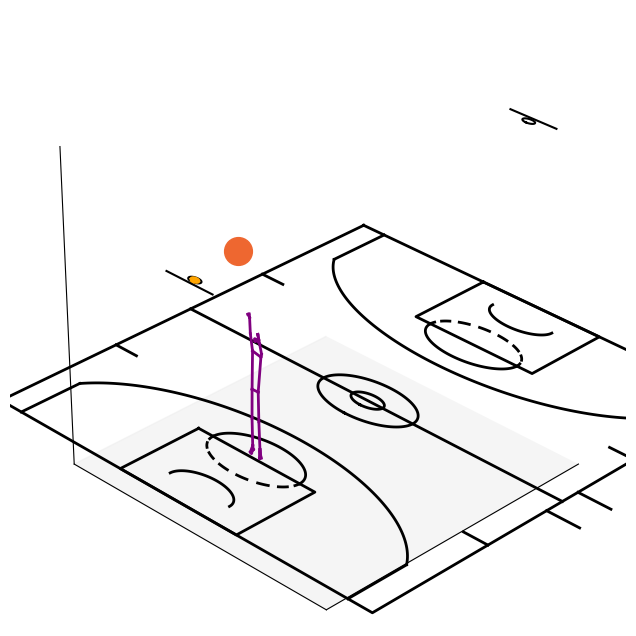

In [6]:
# %%writefile ../../src/phase_labeling.py

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Default connections between joints
connections = [
    ("R_EYE", "L_EYE"), ("R_EYE", "NOSE"), ("L_EYE", "NOSE"),
    ("R_EYE", "R_EAR"), ("L_EYE", "L_EAR"), ("R_SHOULDER", "L_SHOULDER"),
    ("R_SHOULDER", "R_ELBOW"), ("L_SHOULDER", "L_ELBOW"), ("R_ELBOW", "R_WRIST"),
    ("L_ELBOW", "L_WRIST"), ("R_SHOULDER", "R_HIP"), ("L_SHOULDER", "L_HIP"),
    ("R_HIP", "L_HIP"), ("R_HIP", "R_KNEE"), ("L_HIP", "L_KNEE"),
    ("R_KNEE", "R_ANKLE"), ("L_KNEE", "L_ANKLE"), ("R_WRIST", "R_1STFINGER"),
    ("R_WRIST", "R_5THFINGER"), ("L_WRIST", "L_1STFINGER"), ("L_WRIST", "L_5THFINGER"),
    ("R_ANKLE", "R_1STTOE"), ("R_ANKLE", "R_5THTOE"), ("L_ANKLE", "L_1STTOE"),
    ("L_ANKLE", "L_5THTOE"), ("R_ANKLE", "R_CALC"), ("L_ANKLE", "L_CALC"),
    ("R_1STTOE", "R_5THTOE"), ("L_1STTOE", "L_5THTOE"), ("R_1STTOE", "R_CALC"),
    ("L_1STTOE", "L_CALC"), ("R_5THTOE", "R_CALC"), ("L_5THTOE", "L_CALC"),
    ("R_1STFINGER", "R_5THFINGER"), ("L_1STFINGER", "L_5THFINGER")
]

def calculate_distance(x1, y1, z1, x2, y2, z2):
    """
    Calculate the Euclidean distance between two 3D points.

    Parameters:
    - x1, y1, z1: Coordinates of the first point.
    - x2, y2, z2: Coordinates of the second point.

    Returns:
    - The Euclidean distance as a float.
    """
    return np.sqrt((x2 - x1)**2 + (y2 - y1)**2 + (z2 - z1)**2)

def label_ball_in_hands(df, hand_threshold=0.4, debug=False):
    """
    Label when the ball is in the hands by calculating distances between the ball and finger positions.

    Parameters:
    - df: DataFrame containing ball and hand joint positions.
    - hand_threshold: Distance threshold to determine if the ball is in hand.
    - debug: If True, prints debug information.

    Returns:
    - df: DataFrame with 'ball_in_hands' column indicating if the ball is in hand (1) or not (0).
    """
    df['dist_ball_R_1STFINGER'] = calculate_distance(
        df['ball_x'], df['ball_y'], df['ball_z'],
        df['R_1STFINGER_x'], df['R_1STFINGER_y'], df['R_1STFINGER_z']
    )
    df['dist_ball_R_5THFINGER'] = calculate_distance(
        df['ball_x'], df['ball_y'], df['ball_z'],
        df['R_5THFINGER_x'], df['R_5THFINGER_y'], df['R_5THFINGER_z']
    )
    df['dist_ball_L_1STFINGER'] = calculate_distance(
        df['ball_x'], df['ball_y'], df['ball_z'],
        df['L_1STFINGER_x'], df['L_1STFINGER_y'], df['L_1STFINGER_z']
    )
    df['dist_ball_L_5THFINGER'] = calculate_distance(
        df['ball_x'], df['ball_y'], df['ball_z'],
        df['L_5THFINGER_x'], df['L_5THFINGER_y'], df['L_5THFINGER_z']
    )
    # Determine if ball is in hand based on threshold
    df['ball_in_hands'] = ((df['dist_ball_R_1STFINGER'] < hand_threshold) |
                           (df['dist_ball_R_5THFINGER'] < hand_threshold) |
                           (df['dist_ball_L_1STFINGER'] < hand_threshold) |
                           (df['dist_ball_L_5THFINGER'] < hand_threshold)).astype(int)
    
    if debug:
        print("Debug: Ball-in-hand labeling completed.")
        print("Debug: Ball-in-hand table columns =", df.columns)
        print("Debug: Ball-in-hand table additions example =", df[['dist_ball_L_5THFINGER', 'dist_ball_L_1STFINGER']].head(5))
    return df

def label_shooting_motion(df, debug=False):
    """
    Label frames indicating shooting motion based on ball position relative to average shoulder height,
    extending the motion for 5 frames after the ball leaves the hands.

    Parameters:
    - df: DataFrame with ball and shoulder data.
    - debug: If True, prints debug information.

    Returns:
    - df: DataFrame with 'shooting_motion' column (1 for shooting motion, 0 otherwise).
    """
    df = label_ball_in_hands(df, debug=debug)
    df['shooting_motion'] = 0
    df['avg_shoulder_height'] = (df['R_SHOULDER_z'] + df['L_SHOULDER_z']) / 2

    # Identify shooting motion conditionally
    start_motion_condition = (df['ball_in_hands'] == 1) & (df['ball_z'] >= df['avg_shoulder_height'])
    df.loc[start_motion_condition, 'shooting_motion'] = 1

    # Track when motion starts and propagate shooting motion
    df['motion_group'] = start_motion_condition.cumsum()  # Grouping identifier for shooting motion
    shooting_groups = df['motion_group'].unique()
    shooting_groups = shooting_groups[shooting_groups > 0]  # Ignore group 0 (non-shooting frames)

    # Extend shooting motion for 5 frames after the ball leaves the hands
    for group in shooting_groups:
        group_indices = df.index[df['motion_group'] == group].tolist()
        if group_indices:
            last_index = group_indices[-1]
            extension_indices = range(last_index + 1, last_index + 5)  # Extend by 5 frames
            valid_extension_indices = [i for i in extension_indices if i < len(df)]
            df.loc[valid_extension_indices, 'shooting_motion'] = 1

    # Drop the helper column if not needed for debugging
    df.drop(columns='motion_group', inplace=True)

    if debug:
        print("Debug: Shooting motion labeled and extended by 5 frames.")
        print("Debug: Shooting motion table columns =", df.columns)
        print("Debug: Shooting motion example =", df[['frame_time', 'shooting_motion', 'ball_in_hands']].head(15))
        
    return df



def find_release_point(df, debug=False):
    """
    Identify the release point of the shot by finding frames where elbows are above shoulder height 
    and then identifying the frame with the maximum vertical ball velocity during the shooting motion
    while the ball is still in hand.

    Parameters:
    - df: DataFrame containing motion and ball data.
    - debug: If True, prints step-by-step debug information.

    Returns:
    - df: DataFrame with 'release_point_filter' column marking the release point.
    """
    df['release_point_filter'] = 0  # Initialize with 0 for all frames

    # Make a copy of the subset to avoid modifying the original DataFrame directly
    shooting_motion_df = df[(df['shooting_motion'] == 1) & (df['ball_in_hands'] == 1)].copy()
    
    # Calculate the average shoulder height for frames within the shooting motion
    shooting_motion_df['avg_shoulder_height'] = (
        shooting_motion_df['R_SHOULDER_z'] + shooting_motion_df['L_SHOULDER_z']
    ) / 2
    
    if debug:
        print("Debug: Calculating average shoulder height for shooting frames.")
    
    # Filter frames where both elbows are above shoulder height
    elbows_above_shoulder_df = shooting_motion_df[
        (shooting_motion_df['R_ELBOW_z'] >= shooting_motion_df['avg_shoulder_height']) &
        (shooting_motion_df['L_ELBOW_z'] >= shooting_motion_df['avg_shoulder_height'])
    ]
    
    # Ensure we have enough frames after the threshold is met
    if not elbows_above_shoulder_df.empty:
        # Shift by 2 frames after the first occurrence of elbows above shoulder height
        first_above_shoulder_index = elbows_above_shoulder_df.index[0] + 3

        # Filter the subset to include frames starting from the two-frame offset
        filtered_df = shooting_motion_df.loc[first_above_shoulder_index:]
        
        # Identify the frame with maximum vertical ball velocity in the filtered set
        if not filtered_df.empty:
            max_velocity_frame = filtered_df.loc[
                filtered_df['ball_velocity_z'] == filtered_df['ball_velocity_z'].max(), 'frame_time'
            ].values
            
            if max_velocity_frame.size > 0:
                max_velocity_frame_time = max_velocity_frame[0]
                release_frame_index = filtered_df.index[filtered_df['frame_time'] == max_velocity_frame_time].tolist()
                
                if release_frame_index:
                    release_index = release_frame_index[0]
                    # Using .loc on the original df to avoid SettingWithCopyWarning
                    df.loc[release_index, 'release_point_filter'] = 1  # Mark release frame with 1
                    if debug:
                        print(f"Debug: Release frame found at index {release_index}, frame time {max_velocity_frame_time}")
                        print("Debug: Release point column updated for release frame.")
    else:
        if debug:
            print("Debug: No valid frames found for release point determination.")
    
    return df




def main_label_shot_phases(df, debug=False):
    """
    Main function to label phases of a basketball shot: identifies the shooting motion 
    and determines the release point.

    Parameters:
    - df: DataFrame containing ball and joint data.
    - debug: If True, prints debug information at each step.

    Returns:
    - df: DataFrame with labeled shot phases, including 'shooting_motion' and 'release_point_filter'.
    """
    df = label_shooting_motion(df, debug=debug)
    df = find_release_point(df, debug=debug)
    
    if debug:
        print("Debug: DataFrame head with shooting motion and release point labels:")
        print(df[['frame_time', 'shooting_motion', 'ball_in_hands', 'release_point_filter']].head(10))
    return df


# Example of how to use these functions in practice:
if __name__ == "__main__":
    # from data_loading.load_and_parse import load_single_ft_and_parse
    # from data_preprocessing.dataframe_creation import main_create_dataframe
    # from velocity_and_speed_calc import calculate_ball_speed_velocity_direction
    # from visualization_functions import animate_trial_from_df
    
    # Load and prepare the DataFrame (replace this with actual loading code)
    data, trial_id, result, landing_x, landing_y, entry_angle, _ = load_single_ft_and_parse("../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0088.json", debug=False)
    df = main_create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=False)

    # Calculate ball speed, velocity, and direction
    df = calculate_ball_speed_velocity_direction(df, debug=False)

    # Label shot phases, find release frame, and mark the release point filter
    df = main_label_shot_phases(df, debug=False)
    
    print("Final DataFrame after labeling:", df)
    print("Final DataFrame columns:", df.columns)
    
    # Display animation if a release frame is marked in the DataFrame
    if df['release_point_filter'].sum() > 0:
        release_frame_index = df.index[df['release_point_filter'] == 1].tolist()[0]
        
        # Set parameters for visualization
        xbuffer = 10.0  # Adjust as needed
        ybuffer = 10.0  # Adjust as needed
        elev = 30      # Adjust for better camera angle
        azim = 45      # Adjust for better camera angle
        zlim = 15      # Adjust for height
        
        # Call the animation function
        display(animate_trial_from_df(
            df, 
            release_frame_index, 
            connections, 
            xbuffer=xbuffer, 
            ybuffer=ybuffer, 
            zlim=zlim, 
            elev=elev, 
            azim=azim, 
            debug=True  # Enable detailed logging for troubleshooting
        ))
    else:
        print("Debug: No valid release frame found.")





In [7]:
# %%writefile ../../src/ball_trajectory_and_release_time_stats.py

import numpy as np
import pandas as pd
import math

def calculate_dt(df, time_column='frame_time', debug=False):
    """
    Calculate the time delta ('dt') between frames and handle initial NaN values.
    
    Parameters:
    - df: DataFrame containing the time column.
    - time_column: The column name containing time values in milliseconds.
    - debug: If True, prints detailed debug information and validation checks.
    
    Returns:
    - df with an added 'dt' column, forward-filled and validated.
    """
    # Calculate 'dt' as the difference in time between consecutive frames in seconds
    df['dt'] = df[time_column].diff() / 1000.0  # Convert ms to seconds
    
    # Check for initial NaN or zero values in 'dt' and forward fill them
    if pd.isna(df['dt'].iloc[1]) or df['dt'].iloc[1] <= 0:
        df['dt'] = df['dt'].ffill()

    # Handle the first row NaN specifically by assigning a default value if it persists
    if pd.isna(df.loc[0, 'dt']):
        df.loc[0, 'dt'] = df['dt'].iloc[1:].mean()  # Use mean of subsequent values as an estimate

    # Additional validation checks
    if debug:
        # Ensure there are no null values in 'dt' after filling
        if df['dt'].isnull().any():
            print("Warning: 'dt' still contains NaN values after forward fill.")
        else:
            print("Debug: No NaN values in 'dt' after forward fill.")

        # Ensure 'dt' values are all positive
        if (df['dt'] <= 0).any():
            print("Warning: 'dt' contains non-positive values. Check the time column for consistency.")
        else:
            print("Debug: All 'dt' values are positive.")

        # Output some sample values for verification
        print("Debug: 'dt' calculated with forward fill. Sample values:", df['dt'].head())

        # Check if 'dt' values are reasonably consistent (not fluctuating unexpectedly)
        dt_std = df['dt'].std()
        dt_mean = df['dt'].mean()
        if dt_std > dt_mean * 0.1:
            print(f"Warning: 'dt' values have high variance (std={dt_std:.4f}). This could indicate inconsistencies in time intervals.")

    return df




def calculate_ball_dynamics(df, release_frame_index, debug=False):
    """
    Calculate ball speed, velocity, and direction starting from the release frame.
    """
    # Set pre-release frames to NaN for dynamics
    df.loc[:release_frame_index, ['ball_velocity_x', 'ball_velocity_y', 'ball_velocity_z', 'ball_speed', 'ball_direction_x', 'ball_direction_y', 'ball_direction_z']] = np.nan

    # Calculate 'dt' using the helper function
    df = calculate_dt(df, time_column='frame_time', debug=debug)

    # Calculate differences for dynamics
    df['dx'] = df['ball_x'].diff()
    df['dy'] = df['ball_y'].diff()
    df['dz'] = df['ball_z'].diff()

    # Calculate velocities and speed
    df['ball_velocity_x'] = df['dx'] / df['dt']
    df['ball_velocity_y'] = df['dy'] / df['dt']
    df['ball_velocity_z'] = df['dz'] / df['dt']
    df['ball_speed'] = np.sqrt(df['ball_velocity_x']**2 + df['ball_velocity_y']**2 + df['ball_velocity_z']**2)
    df['ball_direction_x'] = df['ball_velocity_x'] / df['ball_speed']
    df['ball_direction_y'] = df['ball_velocity_y'] / df['ball_speed']
    df['ball_direction_z'] = df['ball_velocity_z'] / df['ball_speed']
    df[['ball_direction_x', 'ball_direction_y', 'ball_direction_z']] = df[['ball_direction_x', 'ball_direction_y', 'ball_direction_z']].fillna(0)

    return df



def extract_release_features(df, release_frame_index, debug=False):
    """
    Extracts key features at the release frame for machine learning and visualization.
    """
    if release_frame_index is None:
        if debug:
            print("Debug: No release frame found.")
        return pd.DataFrame()  # Return empty DataFrame if no release frame

    release_row = df.iloc[release_frame_index]

    release_features = {
        'release_ball_speed': release_row['ball_speed'],
        'release_ball_velocity_x': release_row['ball_velocity_x'],
        'release_ball_velocity_y': release_row['ball_velocity_y'],
        'release_ball_velocity_z': release_row['ball_velocity_z'],
        'release_ball_direction_x': release_row['ball_direction_x'],
        'release_ball_direction_y': release_row['ball_direction_y'],
        'release_ball_direction_z': release_row['ball_direction_z'],
        'release_ball_x': release_row['ball_x'],
        'release_ball_y': release_row['ball_y'],
        'release_ball_z': release_row['ball_z'],
        'release_frame_time': release_row['frame_time']
    }

    # Calculate release angle
    horizontal_velocity = np.hypot(release_features['release_ball_velocity_x'], release_features['release_ball_velocity_y'])
    release_features['release_angle'] = math.degrees(math.atan2(release_features['release_ball_velocity_z'], horizontal_velocity))

    # Calculate time to peak height
    g = -9.81  # Gravity
    release_features['time_to_peak'] = -release_features['release_ball_velocity_z'] / g

    # Calculate peak height relative to release height
    peak_height = release_features['release_ball_z'] + (release_features['release_ball_velocity_z'] ** 2) / (2 * -g)
    release_features['peak_height_relative'] = peak_height - release_features['release_ball_z']

    return pd.DataFrame([release_features])  # Return as a single-row DataFrame



def project_ball_trajectory(df, release_index, debug=False):
    """
    Project the ball's trajectory based on release dynamics.
    """
    g = -9.81  # Gravity
    release_row = df.iloc[release_index]

    vx = release_row['ball_velocity_x']
    vy = release_row['ball_velocity_y']
    vz = release_row['ball_velocity_z']
    x0, y0, z0 = release_row['ball_x'], release_row['ball_y'], release_row['ball_z']

    projection_time = np.linspace(0, 2, num=200)
    dt = projection_time[1] - projection_time[0]

    x_proj = x0 + vx * projection_time
    y_proj = y0 + vy * projection_time
    z_proj = z0 + vz * projection_time + 0.5 * g * projection_time**2

    valid_indices = z_proj >= 0  # Keep trajectory points above ground level
    x_proj = x_proj[valid_indices]
    y_proj = y_proj[valid_indices]
    z_proj = z_proj[valid_indices]
    proj_time = projection_time[valid_indices]

    if debug:
        print("Debug: Projected ball trajectory up to impact point.")

    return proj_time, x_proj, y_proj, z_proj


def main_ball_trajectory_analysis(df, release_frame_index, debug=False):
    """
    Main analysis function to calculate dynamics and extract release features.
    """
    if release_frame_index is None:
        if debug:
            print("Debug: No release frame found.")
        return df, None, None, None  # Return placeholders for consistency

    df = calculate_ball_dynamics(df, release_frame_index, debug=debug)

    if debug:
        print("Debug: Release frame index:", release_frame_index)
        print("Debug: Frame data at release:\n", df.loc[release_frame_index])

    # Extract release features for ML
    ml_metrics_df = extract_release_features(df, release_frame_index, debug=debug)
    proj_time, x_proj, y_proj, z_proj = project_ball_trajectory(df, release_frame_index, debug=debug)

    # Projection results for visualization
    projection_df = pd.DataFrame({
        'projection_time': proj_time,
        'projected_x': x_proj,
        'projected_y': y_proj,
        'projected_z': z_proj
    })

    return df, release_frame_index, projection_df, ml_metrics_df


# Example usage
if __name__ == "__main__":
    # Placeholder functions for data loading and creation
    data, trial_id, result, landing_x, landing_y, entry_angle, _ = load_single_ft_and_parse(
        "../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json"
    )
    df = main_create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=False)
    df = calculate_ball_speed_velocity_direction(df, debug=False)
    df = main_label_shot_phases(df, debug=False)
    release_frame_index = df.index[df['release_point_filter'] == 1].tolist()[0]

    df, release_index, projection_df, ml_metrics_df = main_ball_trajectory_analysis(df, release_frame_index, debug=True)
    print("Final DataFrame with release features and trajectory data:\n", df)
    print("ML Metrics DataFrame for model input:\n", ml_metrics_df)


Debug: No NaN values in 'dt' after forward fill.
Debug: All 'dt' values are positive.
Debug: 'dt' calculated with forward fill. Sample values: 0    0.033328
1    0.033000
2    0.033000
3    0.034000
4    0.033000
Name: dt, dtype: float64
Debug: Release frame index: 105
Debug: Frame data at release:
 trial_id                 T0001
result                       0
landing_x                 7.15
landing_y               12.755
entry_angle               40.9
                         ...  
release_point_filter         1
dt                       0.034
dx                       0.127
dy                       0.001
dz                       0.312
Name: 105, Length: 110, dtype: object
Debug: Projected ball trajectory up to impact point.
Final DataFrame with release features and trajectory data:
     trial_id  result  landing_x  landing_y  entry_angle  frame_time  ball_x  \
0      T0001       0       7.15     12.755         40.9        2200  39.667   
1      T0001       0       7.15     12.755       

### How Joint Power (Speed) is Calculated

In the context of this code, **joint power** is calculated as the speed of a joint’s movement from one frame to the next, assuming constant mass. This simplifies the concept of power in biomechanics to mean the **rate of movement** or **speed** at each time point. Below is a detailed breakdown of how this is done:

1. **Coordinate Differences**:
   - Each joint’s position in 3D space is represented by its x, y, and z coordinates (`joint_x`, `joint_y`, `joint_z`) in each frame.
   - The **difference** in position for each coordinate from one frame to the next is calculated using the `.diff()` method on each coordinate column. This method provides the change in position for each coordinate.

2. **Euclidean Distance Calculation**:
   - Using the differences in x, y, and z coordinates (`dx`, `dy`, `dz`), we calculate the **Euclidean distance** moved by the joint between frames.
   - This distance is given by the formula:
     \[
     \text{distance} = \sqrt{(\Delta x)^2 + (\Delta y)^2 + (\Delta z)^2}
     \]
   - This distance represents the **displacement** of the joint in 3D space from one frame to the next.

3. **Time Difference (dt)**:
   - The time difference between frames is stored in the `dt` column, calculated as the difference in `frame_time` divided by 1000 to convert milliseconds to seconds.
   - The `dt` value provides the **time interval** over which the displacement occurred.

4. **Speed Calculation**:
   - The speed, or **rate of displacement** (which we refer to as power in this context), is calculated by dividing the Euclidean distance by the time interval `dt`:
     \[
     \text{speed} = \frac{\text{distance}}{\text{dt}}
     \]
   - This calculation provides the **speed of the joint in each frame**, representing how quickly the joint is moving from one position to the next.

5. **Per-frame Joint Power Column**:
   - For each joint, the calculated speed for each frame is stored in a new column named `{joint}_ongoing_power`, where `{joint}` represents the specific joint (e.g., `L_ANKLE_ongoing_power`).
   - This column contains the joint’s movement speed at each time step, which we can interpret as the ongoing power for that joint throughout the movement sequence.

### Example Calculation for a Single Joint (e.g., L_ANKLE)

Consider the `L_ANKLE` joint as an example. The steps for calculating the ongoing power (speed) for `L_ANKLE` in a specific frame might look like this:

1. **Calculate Differences**:
   - Compute the change in `L_ANKLE_x`, `L_ANKLE_y`, and `L_ANKLE_z` positions from the previous frame.
     \[
     \Delta x = \text{current } L\_ANKLE\_x - \text{previous } L\_ANKLE\_x
     \]
     \[
     \Delta y = \text{current } L\_ANKLE\_y - \text{previous } L\_ANKLE\_y
     \]
     \[
     \Delta z = \text{current } L\_ANKLE\_z - \text{previous } L\_ANKLE\_z
     \]

2. **Euclidean Distance (Displacement)**:
   - Using the differences, calculate the displacement:
     \[
     \text{distance} = \sqrt{(\Delta x)^2 + (\Delta y)^2 + (\Delta z)^2}
     \]

3. **Calculate Speed**:
   - Divide the calculated distance by the time difference `dt` for that frame:
     \[
     \text{L\_ANKLE\_ongoing\_power} = \frac{\text{distance}}{\text{dt}}
     \]

4. **Store in DataFrame**:
   - The value is then stored in the column `L_ANKLE_ongoing_power` for that specific frame.

### Joint Power Metrics Calculation (During Shooting Motion Only)

The code calculates metrics such as **minimum, maximum, mean, and standard deviation** of each joint’s ongoing power, but only for frames during the **shooting motion phase** (`shooting_motion == 1`):

- For each joint, metrics are calculated based on the values in the `{joint}_ongoing_power` column where `shooting_motion == 1`, resulting in metrics that specifically capture the joint’s movement characteristics during the shooting phase.
  
These metrics are then stored in `joint_power_metrics_df`, providing summary statistics for each joint’s movement during the critical shooting phase.


In [8]:
# %%writefile ../../src/joint_power_calc.py
import numpy as np
import pandas as pd

def calculate_joint_speed(df, joint):
    """Calculate the speed for a specified joint over the entire DataFrame."""
    speed = np.sqrt(
        (df[f'{joint}_x'].diff() ** 2) +
        (df[f'{joint}_y'].diff() ** 2) +
        (df[f'{joint}_z'].diff() ** 2)
    ) / df['dt']
    return speed

def add_ongoing_power_columns(df, joints):
    """
    Adds ongoing power (speed) columns for each joint in the main DataFrame.
    """
    for joint in joints:
        if {f'{joint}_x', f'{joint}_y', f'{joint}_z'}.issubset(df.columns):
            df[f'{joint}_ongoing_power'] = calculate_joint_speed(df, joint)
        else:
            print(f"Warning: Missing coordinates for joint '{joint}'.")
    return df

def calculate_joint_power_metrics(df, joints, debug=False):
    """
    Calculate overall metrics for each joint's ongoing power during shooting motion.
    """
    joint_power_metrics = {}
    # Filter the DataFrame to include only shooting motion frames
    shooting_motion_df = df[df['shooting_motion'] == 1]
    
    for joint in joints:
        power_column = f'{joint}_ongoing_power'
        if power_column in df.columns:
            joint_power = shooting_motion_df[power_column]
            # Calculate metrics only during shooting motion
            joint_power_metrics.update({
                f'{joint}_min_power': joint_power.min(),
                f'{joint}_max_power': joint_power.max(),
                f'{joint}_avg_power': joint_power.mean(),
                f'{joint}_std_power': joint_power.std(),
            })
            if debug:
                print(f"Debug: Calculated metrics for {joint}: {joint_power_metrics}")
        else:
            print(f"Warning: {power_column} not found in DataFrame.")
    return pd.DataFrame([joint_power_metrics])

def main_calculate_joint_power(df, release_frame_index, debug=False):
    """
    Main function to calculate ongoing joint power and overall metrics.
    """
    joints = [
        'L_ANKLE', 'R_ANKLE', 'L_KNEE', 'R_KNEE', 'L_HIP', 'R_HIP',
        'L_ELBOW', 'R_ELBOW', 'L_WRIST', 'R_WRIST',
        'L_1STFINGER', 'L_5THFINGER', 'R_1STFINGER', 'R_5THFINGER'
    ]
    if debug:
        print("Debug: Starting joint power calculations...")
    
    # Step 1: Add ongoing power columns directly to df
    df = add_ongoing_power_columns(df, joints)
    
    # Step 2: Calculate joint power metrics during shooting motion
    joint_power_metrics_df = calculate_joint_power_metrics(df, joints, debug=debug)
    
    if debug:
        print("Debug: Joint power calculations completed.")
    
    # Return df with ongoing power columns and the metrics DataFrame
    return df, joint_power_metrics_df

if __name__ == "__main__":
    # Load and process data
    print("Debug: Loading and parsing file: ../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json")
    data, trial_id, result, landing_x, landing_y, entry_angle, _ = load_single_ft_and_parse(
        "../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json"
    )
    debug = True
    df = main_create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=False)
    
    df = calculate_ball_speed_velocity_direction(df, debug=False)
    df = main_label_shot_phases(df)
    release_frame_index = df.index[df['release_point_filter'] == 1].tolist()[0]
    
    df, release_index, projection_df, ml_metrics_df = main_ball_trajectory_analysis(df, release_frame_index, debug=True)
    print("Final DataFrame with release features and trajectory data:\n", df)
    print("columns = ", df.columns)
    
    joints = [
        'L_ANKLE', 'R_ANKLE', 'L_KNEE', 'R_KNEE', 'L_HIP', 'R_HIP',
        'L_ELBOW', 'R_ELBOW', 'L_WRIST', 'R_WRIST',
        'L_1STFINGER', 'L_5THFINGER', 'R_1STFINGER', 'R_5THFINGER'
    ]

    # Step 1: Calculate joint power and metrics
    df, joint_power_metrics_df = main_calculate_joint_power(df, release_frame_index, debug=debug)
    
    # Now you have:
    # - df: Main DataFrame with added per-frame joint power columns
    # - joint_power_metrics_df: DataFrame with joint power metrics calculated during shooting motion
    
    print("DataFrame with ongoing joint power columns added:\n", df.head())
    print("Joint Power Metrics DataFrame (during shooting motion):\n", joint_power_metrics_df)



Debug: Loading and parsing file: ../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json
Debug: No NaN values in 'dt' after forward fill.
Debug: All 'dt' values are positive.
Debug: 'dt' calculated with forward fill. Sample values: 0    0.033328
1    0.033000
2    0.033000
3    0.034000
4    0.033000
Name: dt, dtype: float64
Debug: Release frame index: 105
Debug: Frame data at release:
 trial_id                 T0001
result                       0
landing_x                 7.15
landing_y               12.755
entry_angle               40.9
                         ...  
release_point_filter         1
dt                       0.034
dx                       0.127
dy                       0.001
dz                       0.312
Name: 105, Length: 110, dtype: object
Debug: Projected ball trajectory up to impact point.
Final DataFrame with release features and trajectory data:
     trial_id  result  landing_x  landing_y  entry_angle  frame_time  ball_x  \
0      T0001       0

In [9]:
# %%writefile ../../src/joint_angles_details.py
import numpy as np
import pandas as pd

def calculate_joint_angle(joint_a, joint_b, joint_c):
    """
    Calculate the angle between three points (joint_a, joint_b, joint_c).
    """
    vector_ab = joint_b - joint_a
    vector_bc = joint_c - joint_b
    dot_product = np.dot(vector_ab, vector_bc)
    mag_ab = np.linalg.norm(vector_ab)
    mag_bc = np.linalg.norm(vector_bc)

    if mag_ab == 0 or mag_bc == 0:
        return 0.0

    angle = np.arccos(dot_product / (mag_ab * mag_bc))
    return np.degrees(angle)

def calculate_joint_angles_over_motion(df, release_frame_index, side='R', debug=False):
    """
    Calculate joint angles over motion, allowing selection of side ('L' for left, 'R' for right).

    Parameters:
    - df: DataFrame containing motion data.
    - release_frame_index: Index for the release point.
    - side: 'L' for left side, 'R' for right side.
    - debug: If True, prints debug information.

    Returns:
    - df: Updated DataFrame with joint angle columns.
    - joint_angle_metrics_df: DataFrame with max and release angles for the specified joints.
    """
    # Set up joint combinations based on the selected side
    joint_combinations = {
        'elbow': [f'{side}_SHOULDER', f'{side}_ELBOW', f'{side}_WRIST'],
        'wrist': [f'{side}_ELBOW', f'{side}_WRIST', f'{side}_1STFINGER'],
        'knee': [f'{side}_HIP', f'{side}_KNEE', f'{side}_ANKLE']
    }

    # Step 1: Calculate angles for all rows in the DataFrame
    for joint_name, (a, b, c) in joint_combinations.items():
        df[f'{joint_name}_angle'] = df.apply(
            lambda row: calculate_joint_angle(
                row[[f"{a}_x", f"{a}_y", f"{a}_z"]].values,
                row[[f"{b}_x", f"{b}_y", f"{b}_z"]].values,
                row[[f"{c}_x", f"{c}_y", f"{c}_z"]].values
            ), axis=1
        )
        if debug:
            print(f"Debug: Calculated {side} {joint_name} angles across all rows:\n", df[[f'{joint_name}_angle']].head())

    # Step 2: Filter the DataFrame to get only the shooting motion rows
    shooting_motion_df = df[df['shooting_motion'] == 1]

    # Step 3: Initialize dictionary for max and release angles with single-row format
    joint_angle_metrics = {}

    # Step 4: Calculate max and release angles for each joint within the shooting motion
    for joint_name in joint_combinations.keys():
        max_angle = shooting_motion_df[f'{joint_name}_angle'].max()
        release_angle = (
            shooting_motion_df.at[release_frame_index, f'{joint_name}_angle']
            if release_frame_index in shooting_motion_df.index else np.nan
        )

        # Store these as single-row format columns
        joint_angle_metrics[f'{joint_name}_max_angle'] = max_angle
        joint_angle_metrics[f'{joint_name}_release_angle'] = release_angle

        if debug:
            print(f"Debug: {side} {joint_name} max_angle: {max_angle}, release_angle: {release_angle}")

    # Step 5: Convert metrics dictionary to a single-row DataFrame for output
    joint_angle_metrics_df = pd.DataFrame([joint_angle_metrics])

    # Final debug to check both DataFrames
    if debug:
        print("Debug: Main DataFrame with ongoing joint angles:\n", df.head())
        print("Debug: Joint Angle Metrics DataFrame (single row with max and release angles during shooting motion):\n", joint_angle_metrics_df)

    return df, joint_angle_metrics_df


if __name__ == "__main__":
    # Load and process data
    print("Debug: Loading and parsing file: ../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json")
    data, trial_id, result, landing_x, landing_y, entry_angle, _ = load_single_ft_and_parse(
        "../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json"
    )
    debug = True
    df = main_create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=False)
    
    
    df = calculate_ball_speed_velocity_direction(df, debug=False)
    df = main_label_shot_phases(df)
    release_frame_index = df.index[df['release_point_filter'] == 1].tolist()[0]
    
    df, release_index, projection_df, ml_metrics_df = main_ball_trajectory_analysis(df, 
                                                                                    release_frame_index,
                                                                                    debug=False)
    print("Final DataFrame with release features and trajectory data:\n", df)
    print("columns = ", df.columns)
    
    joints = [
        'L_ANKLE', 'R_ANKLE', 'L_KNEE', 'R_KNEE', 'L_HIP', 'R_HIP',
        'L_ELBOW', 'R_ELBOW', 'L_WRIST', 'R_WRIST',
        'L_1STFINGER', 'L_5THFINGER', 'R_1STFINGER', 'R_5THFINGER'
    ]

    # Step 1: Calculate joint power and metrics
    df, joint_power_metrics_df = main_calculate_joint_power(df, release_frame_index, debug=False)
    
    # Now you have:
    # - df: Main DataFrame with added per-frame joint power columns
    # - joint_power_metrics_df: DataFrame with joint power metrics calculated during shooting motion
    
    print("DataFrame with ongoing joint power columns added:\n", df.head())
    print("Joint Power Metrics DataFrame (during shooting motion):\n", joint_power_metrics_df)

    # Calculate Joint Angles Across All Rows and Get Metrics for Shooting Motion
    df, joint_angle_metrics_df = calculate_joint_angles_over_motion(df, release_frame_index, side='R', debug=True)
    print("Final DataFrame with ongoing joint angles across all rows:\n", df.head())
    print("Joint Angle Metrics DataFrame (max and release angles during shooting motion):\n", joint_angle_metrics_df)

    # metrics df's for machine learning dataset and base dataset
    # - joint_power_metrics_df: DataFrame with joint power metrics calculated during shooting motion
    # - joint_angle_metrics_df (max and release angles during shooting motion)
    # - shot_details_df = df[['result', 'landing_x', 'landing_y', 'entry_angle']].drop_duplicates()
    # ^ shot_details_df are the base metrics from the dataset and the y variable = result

Debug: Loading and parsing file: ../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json
Final DataFrame with release features and trajectory data:
     trial_id  result  landing_x  landing_y  entry_angle  frame_time  ball_x  \
0      T0001       0       7.15     12.755         40.9        2200  39.667   
1      T0001       0       7.15     12.755         40.9        2233  39.604   
2      T0001       0       7.15     12.755         40.9        2266  39.556   
3      T0001       0       7.15     12.755         40.9        2300  39.465   
4      T0001       0       7.15     12.755         40.9        2333  39.440   
..       ...     ...        ...        ...          ...         ...     ...   
112    T0001       0       7.15     12.755         40.9        5933  29.353   
113    T0001       0       7.15     12.755         40.9        5966  29.688   
114    T0001       0       7.15     12.755         40.9        6000  30.080   
115    T0001       0       7.15     12.755

In [10]:
# %%writefile ../../src/key_feature_extraction.py
import pandas as pd
import numpy as np
import json


def estimate_basketball_stats(height_m):
    """
    Estimate basketball-specific stats based on height.

    Args:
        height_m (float): Height of the player in meters.
    
    Returns:
        dict: Dictionary containing estimated basketball metrics.
    """
    # Convert height to centimeters for better readability in basketball context
    height_cm = height_m * 100
    
    # Estimate wingspan (average is roughly 1.06x height)
    wingspan_cm = height_cm * 1.06
    
    # Estimate standing reach (average for males is height in cm * 0.92 + 50 cm)
    standing_reach_cm = height_cm * 0.92 + 50
    
    # Estimate hand size (average male hand length is ~0.106x height in cm)
    hand_length_cm = height_cm * 0.106
    
    return {
        "player_estimated_wingspan_cm": round(wingspan_cm, 2),
        "player_estimated_standing_reach_cm": round(standing_reach_cm, 2),
        "player_estimated_hand_length_cm": round(hand_length_cm, 2)
    }

def load_player_info(json_path):
    """
    Load participant information from JSON file and add 'player_' prefix to each metric.
    Additionally, add a 'dominant_hand' key with the value 'R' to indicate right-handedness
    and calculate additional basketball-specific metrics based on height.

    Args:
        json_path (str): Path to the JSON file with player information.
    
    Returns:
        player_info (dict): Dictionary containing player-specific data with 'player_' prefix for each key.
    """
    with open(json_path, 'r') as f:
        player_info = json.load(f)
    
    # Add 'player_' prefix to each key
    player_info = {f"player_{key}": value for key, value in player_info.items()}
    
    # Add dominant hand key
    player_info["player_dominant_hand"] = "R"  # Setting dominant hand to 'R' (Right)
    
    # Estimate basketball-specific stats and add to player_info
    height_m = player_info.get("player_height_in_meters")
    if height_m:
        basketball_stats = estimate_basketball_stats(height_m)
        player_info.update(basketball_stats)
    
    return player_info



def get_column_definitions():
    """
    Define column descriptions for the dataset, including granular free throw data, ML features,
    energy metrics, exhaustion scores, and additional statistics.

    Returns:
        column_definitions (dict): Dictionary where keys are column names and values are descriptions.
    """
    column_definitions = {
        # Basic trial metadata
        'trial_id': "Unique identifier for each trial, formatted as 'Txxxx'.",
        'shot_id': "Sequential shot ID for organizing shots within a trial.",
        'result': "Binary indicator of shot outcome: 1 if made, 0 if missed.",
        
        # Free throw shot landing and entry characteristics
        'landing_x': "X coordinate of ball landing position on the hoop plane, measured in inches with the hoop front as origin.",
        'landing_y': "Y coordinate of ball landing position on the hoop plane, measured in inches with the hoop front as origin.",
        'entry_angle': "Angle at which the ball enters the hoop plane, measured in degrees to indicate entry precision.",

        # Frame and timing information
        'frame_time': "Timestamp in milliseconds for each frame, relative to trial start.",
        'dt': "Time delta between consecutive frames in seconds, used to calculate velocities and accelerations.",
        'by_trial_time': "Time within a specific trial, calculated as time elapsed from the trial start.",
        'continuous_frame_time': "Cumulative time across all trials, accounting for the trial offsets.",

        # Ball position and dynamics
        'ball_x': "X coordinate of the ball's position on the court, representing lateral position in feet, based on the center of the court.",
        'ball_y': "Y coordinate of the ball's position on the court, representing forward/backward position in feet from the center of the court.",
        'ball_z': "Z coordinate of the ball's position, representing height in feet off the court (vertical position).",
        'ball_speed': "Overall speed of the ball, derived from the 3D velocities (Pythagorean theorem of x, y, z velocities).",
        'overall_ball_velocity': "Magnitude of the ball's velocity vector, indicating its total speed at any moment.",

        # Exhaustion and energy metrics
        'joint_energy': "Energy expended by a specific joint in a single frame, calculated as power multiplied by time delta.",
        'joint_energy_by_trial': "Cumulative energy expended by a specific joint within a trial.",
        'joint_energy_by_trial_exhaustion_score': "Normalized exhaustion score for a specific joint within a trial, scaled to the maximum trial energy.",
        'joint_energy_overall_cumulative': "Cumulative energy expended by a specific joint across all trials.",
        'joint_energy_overall_exhaustion_score': "Normalized exhaustion score for a specific joint across all trials, scaled to the maximum overall energy.",

        'total_energy': "Total energy expended by all joints in a single frame, calculated as the sum of joint energies.",
        'by_trial_energy': "Cumulative energy expended during a specific trial, calculated as the sum of total energy across frames.",
        'by_trial_exhaustion_score': "Exhaustion score normalized within each trial, calculated as cumulative energy divided by maximum energy in the trial.",
        'overall_cumulative_energy': "Cumulative energy expended across all trials, calculated as a running sum of total energy across frames.",
        'overall_exhaustion_score': "Exhaustion score normalized across all trials, calculated as cumulative energy divided by the maximum cumulative energy.",

        # Joint-specific energy and exhaustion metrics
        'L_ANKLE_energy_by_trial': "Energy expended by the left ankle during a specific trial, calculated as power multiplied by time delta.",
        'L_ANKLE_energy_by_trial_exhaustion_score': "Exhaustion score for the left ankle energy in a trial, normalized to the maximum trial energy.",
        'L_ANKLE_energy_overall_cumulative': "Cumulative energy expended by the left ankle across all trials.",
        'L_ANKLE_energy_overall_exhaustion_score': "Exhaustion score for the left ankle energy across all trials, normalized to the maximum cumulative energy.",
        # Similarly for R_ANKLE, L_KNEE, R_KNEE, L_HIP, R_HIP, L_ELBOW, R_ELBOW, L_WRIST, R_WRIST

        # Joint angles and release metrics
        'elbow_angle': "Angle at the elbow joint during motion, useful for tracking shooting form.",
        'wrist_angle': "Angle at the wrist joint, essential for understanding release dynamics.",
        'knee_angle': "Angle at the knee joint, analyzed to determine player’s stance and motion.",
        'max_elbow_angle': "Maximum angle achieved by the elbow during a trial, indicating the range of motion.",
        'max_wrist_angle': "Maximum angle achieved by the wrist during a trial, indicating the peak of wrist flexion or extension.",
        'max_knee_angle': "Maximum angle achieved by the knee during a trial, indicating the peak of knee flexion or extension.",
        'release_elbow_angle_filtered_optimal_min': "Minimum filtered optimal elbow angle at the release point during shooting motion.",
        'release_knee_angle_initial_optimal_max': "Maximum initial optimal knee angle during shooting motion at the release point.",
        'release_wrist_angle_initial_optimal_min': "Minimum initial optimal wrist angle during shooting motion at the release point.",

        # Power metrics
        'L_ANKLE_ongoing_power': "Calculated power (velocity) for the left ankle during motion.",
        'L_ELBOW_ongoing_power': "Calculated power (velocity) for the left elbow during motion.",
        'R_WRIST_ongoing_power': "Calculated power (velocity) for the right wrist during motion.",
        'L_1STFINGER_ongoing_power': "Calculated power (velocity) for the left first finger during motion.",
        'R_5THFINGER_ongoing_power': "Calculated power (velocity) for the right fifth finger during motion.",
        # Similarly for other joints

        # Shot classification and metrics
        'release_wrist_shot_classification': "Categorical classification of the shot based on wrist angle at the release point.",
        'max_knee_shot_classification': "Categorical classification of the shot based on the maximum knee angle during the trial.",
        'initial_release_angle': "Initial calculated release angle of the ball at the start of the shooting motion.",
        'optimal_release_angle': "Optimal release angle derived from shooting mechanics and trajectory analysis.",
        'calculated_release_angle': "Calculated release angle based on ball velocities and directions.",

        # Distances
        'dist_ball_R_1STFINGER': "Distance between the ball and the right first finger at each frame.",
        'dist_ball_L_5THFINGER': "Distance between the ball and the left fifth finger at each frame.",

        # Miscellaneous
        'avg_shoulder_height': "Average height of the shoulders during the trial, calculated as the mean of left and right shoulder heights.",
        'shooting_motion': "Binary indicator of whether the player is in a shooting motion (1) or not (0).",
        'release_point_filter': "Boolean filter indicating whether the frame meets release point criteria.",
        'initial_release_angle': "the release angle at the frame of the release_point_filter=1",
        'calculated_release_angle': "the average release angle over the 3 frames after the release_point_filter=1",
        'distance_to_basket': "the distance to the basket from the player, input manually by user. Can be calculated through YOLO",
        'optimal_release_angle': 'optimal_release_angle is calculated from the reference table from the 2005 study on optimal angle givent he release height, ball velocity, and such' ,
    }

    return column_definitions



def main_prepare_ml_data(df, joint_power_metrics_df, joint_angle_metrics_df, ml_metrics_df, player_info, debug=False):
    """
    Main function to prepare a single DataFrame for machine learning.

    Args:
        df: DataFrame containing the original data with shot details.
        joint_power_metrics_df: DataFrame with joint power metrics during the shooting motion.
        joint_angle_metrics_df: DataFrame with max and release angles during shooting motion.
        ml_metrics_df: DataFrame containing metrics specific to release dynamics and peak trajectory.
        player_info (dict): Dictionary containing player information (e.g., height, weight).
    
    Returns:
        key_features_dataframe: the final features of this free throw.
    """
    
    # Step 1: Extract essential shot details, including target variables and unique features
    shot_details_df = df[['result', 'landing_x', 'landing_y', 'entry_angle']].drop_duplicates().reset_index(drop=True)
    
    if debug:
        print("Debug: Shot details DataFrame:\n", shot_details_df)

    # Step 2: Combine all metrics and player info into a single row DataFrame for machine learning
    key_features_dataframe = pd.concat(
        [shot_details_df, joint_power_metrics_df, joint_angle_metrics_df, ml_metrics_df],
        axis=1
    )
    
    # Add player information as additional columns
    for key, value in player_info.items():
        key_features_dataframe[key] = value
    
    if debug:
        print("Debug: Combined key features DataFrame with player information for ML:\n", key_features_dataframe)

    return key_features_dataframe

if __name__ == "__main__":
    # Load and process data
    player_info_path = "../../SPL-Open-Data/basketball/freethrow/participant_information.json"
    player_info = load_player_info(player_info_path)
    
    print("Debug: Loaded player info:\n", player_info)
    
    data_path = "../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json"
    print(f"Debug: Loading and parsing file: {data_path}")
    
    data, trial_id, result, landing_x, landing_y, entry_angle, _ = load_single_ft_and_parse(data_path)
    debug = True
    df = main_create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=False)
    
    df = calculate_ball_speed_velocity_direction(df, debug=False)
    df = main_label_shot_phases(df)
    release_frame_index = df.index[df['release_point_filter'] == 1].tolist()[0]
    
    df, release_index, projection_df, ml_metrics_df = main_ball_trajectory_analysis(df, release_frame_index, debug=True)
    print("Final DataFrame with release features and trajectory data:\n", df)
    print("ML Metrics DataFrame for model input:\n", ml_metrics_df)

    joints = [
        'L_ANKLE', 'R_ANKLE', 'L_KNEE', 'R_KNEE', 'L_HIP', 'R_HIP',
        'L_ELBOW', 'R_ELBOW', 'L_WRIST', 'R_WRIST',
        'L_1STFINGER', 'L_5THFINGER', 'R_1STFINGER', 'R_5THFINGER'
    ]

    # Step 1: Calculate joint power and metrics
    df, joint_power_metrics_df = main_calculate_joint_power(df, release_frame_index, debug=debug)
    
    # Now you have:
    # - df: Main DataFrame with added per-frame joint power columns
    # - joint_power_metrics_df: DataFrame with joint power metrics calculated during shooting motion
    
    print("DataFrame with ongoing joint power columns added:\n", df.head())
    print("Joint Power Metrics DataFrame (during shooting motion):\n", joint_power_metrics_df)

    # Calculate Joint Angles Across All Rows and Get Metrics for Shooting Motion
    df, joint_angle_metrics_df = calculate_joint_angles_over_motion(df, release_frame_index, side='R', debug=True)
    print("Final DataFrame with ongoing joint angles across all rows:\n", df.head())
    print("Joint Angle Metrics DataFrame (max and release angles during shooting motion):\n", joint_angle_metrics_df)

    # metrics df's for machine learning dataset and base dataset
    # - joint_power_metrics_df: DataFrame with joint power metrics calculated during shooting motion
    # - joint_angle_metrics_df (max and release angles during shooting motion)
    # - shot_details_df = df[['result', 'landing_x', 'landing_y', 'entry_angle']].drop_duplicates()
    # ^ shot_details_df are the base metrics from the dataset and the y variable = result

    # Prepare the ML dataset
    key_features_dataframe = main_prepare_ml_data(df, joint_power_metrics_df, joint_angle_metrics_df, ml_metrics_df, player_info, debug=True)
    print("Final Key Features DataFrame for ML:\n", key_features_dataframe)
    print("Final Key Features DataFrame Columns for ML:\n", key_features_dataframe.columns)

    #Final Two output tables: df (granular free throw data) and key_features_dataframe for the ML dataset
    
    # Column Definitions
    column_definitions = get_column_definitions()
    print("Column Definitions for the Dataset:\n", column_definitions)

Debug: Loaded player info:
 {'player_participant_id': 'P0001', 'player_height_in_meters': 1.91, 'player_weight__in_kg': 90.7, 'player_dominant_hand': 'R', 'player_estimated_wingspan_cm': 202.46, 'player_estimated_standing_reach_cm': 225.72, 'player_estimated_hand_length_cm': 20.25}
Debug: Loading and parsing file: ../../SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json
Debug: No NaN values in 'dt' after forward fill.
Debug: All 'dt' values are positive.
Debug: 'dt' calculated with forward fill. Sample values: 0    0.033328
1    0.033000
2    0.033000
3    0.034000
4    0.033000
Name: dt, dtype: float64
Debug: Release frame index: 105
Debug: Frame data at release:
 trial_id                 T0001
result                       0
landing_x                 7.15
landing_y               12.755
entry_angle               40.9
                         ...  
release_point_filter         1
dt                       0.034
dx                       0.127
dy                       0.00

In [11]:
# %%writefile ../../src/main_load_and_prepare.py

import os
import pandas as pd
import json
# from load_and_parse import load_single_ft_and_parse
# from dataframe_creation import main_create_dataframe
# from velocity_and_speed_calc import calculate_ball_speed_velocity_direction
# from phase_labeling import main_label_shot_phases
# from ball_trajectory_and_release_time_stats import main_ball_trajectory_analysis
# from joint_angles_details import main_calculate_joint_power, calculate_joint_angles_over_motion
# from key_feature_extraction import main_prepare_ml_data, load_player_info, get_column_definitions

def process_file(file_path, shot_id, player_info, debug=False):
    # Load and parse JSON data
    data, trial_id, result, landing_x, landing_y, entry_angle, _ = load_single_ft_and_parse(file_path)
    if data is None:
        if debug:
            print(f"Debug: Skipping file {file_path} due to parsing error.")
        return pd.DataFrame(), pd.DataFrame()

    # Step 1: Create initial DataFrame from parsed data
    df = main_create_dataframe(data, trial_id, result, landing_x, landing_y, entry_angle, debug=debug)
    df = calculate_ball_speed_velocity_direction(df, debug=debug)
    df = main_label_shot_phases(df)

    # Step 2: Identify release frame
    release_frame_index = df.index[df['release_point_filter'] == 1].tolist()[0] if df['release_point_filter'].sum() > 0 else None
    if release_frame_index is None:
        if debug:
            print(f"Debug: No release frame found for file {file_path}.")
        return pd.DataFrame(), pd.DataFrame()

    # Step 3: Calculate ball dynamics and release metrics first (for `dt` and velocity/direction data)
    df, _, _, ml_metrics_df = main_ball_trajectory_analysis(df, release_frame_index, debug=debug)

    # Step 4: Calculate joint power and joint angle metrics
    df, joint_power_metrics_df = main_calculate_joint_power(df, release_frame_index, debug=debug)
    df, joint_angle_metrics_df = calculate_joint_angles_over_motion(df, release_frame_index, debug=debug)

    # Step 5: Prepare ML features combining shot details, joint power, angles, release metrics, and player info
    key_features_dataframe = main_prepare_ml_data(df, joint_power_metrics_df, joint_angle_metrics_df, ml_metrics_df, player_info, debug=debug)
    key_features_dataframe['trial_id'] = trial_id
    key_features_dataframe['shot_id'] = shot_id

    return df, key_features_dataframe


def bulk_process_directory(directory_path, player_info_path, debug=False):
    # Load player information
    player_info = load_player_info(player_info_path)
    if debug:
        print("Debug: Loaded player info:\n", player_info)

    all_granular_data = []
    all_features = []
    shot_id = 1
    
    for filename in os.listdir(directory_path):
        if filename.endswith(".json"):
            file_path = os.path.join(directory_path, filename)
            if debug:
                print(f"Debug: Processing file: {file_path}")

            granular_df, trial_features_df = process_file(file_path, shot_id, player_info, debug=debug)
            shot_id += 1
            
            if not granular_df.empty and not trial_features_df.empty:
                all_granular_data.append(granular_df)
                all_features.append(trial_features_df)

    final_granular_df = pd.concat(all_granular_data, ignore_index=True) if all_granular_data else pd.DataFrame()
    final_ml_df = pd.concat(all_features, ignore_index=True) if all_features else pd.DataFrame()
    
    if debug:
        print("Debug: Final granular DataFrame created with shape:", final_granular_df.shape)
        print("Debug: Final ML DataFrame created with shape:", final_ml_df.shape)
    
    return final_granular_df, final_ml_df

if __name__ == "__main__":
    directory_path = "../../SPL-Open-Data/basketball/freethrow/data/P0001"
    player_info_path = "../../SPL-Open-Data/basketball/freethrow/participant_information.json"

    # Run the bulk processing with player info integration
    final_granular_df, final_ml_df = bulk_process_directory(directory_path, player_info_path, debug=False)
    
    if not final_granular_df.empty and not final_ml_df.empty:
        print("Debug: Granular free throw data for all trials:")
        print(final_granular_df.head())
        print("Debug: ML Features DataFrame for all trials with player info:")
        print(final_ml_df.head())

        # Column Definitions
        column_definitions = get_column_definitions()
        print("Column Definitions for the Dataset:\n", column_definitions)


Debug: Granular free throw data for all trials:
  trial_id  result  landing_x  landing_y  entry_angle  frame_time  ball_x  \
0    T0001       0       7.15     12.755         40.9        2200  39.667   
1    T0001       0       7.15     12.755         40.9        2233  39.604   
2    T0001       0       7.15     12.755         40.9        2266  39.556   
3    T0001       0       7.15     12.755         40.9        2300  39.465   
4    T0001       0       7.15     12.755         40.9        2333  39.440   

   ball_y  ball_z  R_EYE_x  ...  R_ELBOW_ongoing_power  L_WRIST_ongoing_power  \
0  -1.501   4.279   26.946  ...                    NaN                    NaN   
1  -1.514   4.348   26.970  ...               1.121212               1.203378   
2  -1.527   4.508   26.994  ...               1.144316               1.245746   
3  -1.548   4.596   27.016  ...               1.195797               1.172788   
4  -1.553   4.688   27.036  ...               1.300208               1.057137   

  

# Feature Engineering/ Tool Making


Overall look:

- maximum release point:
  - the maximum kinetic energy is being channeled into the shot from knees, elbows, wrists, jump height (if jump shot or if set shot just the first bit). Check the study to find the most optimal point of kinetic energy
- Exhaustion Levels throughout training
- arc_category: compare to the top vs the bottom max height of the ball to split up arc 


### Once I can exact the release point down past my current filters, too variable so using max for shot meter
current filters: at max ball_velocity_y, elbows above shoulders, add to frames past the elbows above the shoulders
- optimal release point
  - finding the optimal angles and power at release point during made shots to get comfortable range
- optimal shooting motion
  - finding the optimal angles and power at release point during made shots to get comfortable range AT DIFFERENT STAGES throughout shooting motion (maybe shoulder-to-release, release, post release?)

In [12]:
import pandas as pd

# Set option to display all columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)

# Print all columns for both DataFrames
print("final_ml_df columns:\n", final_ml_df.columns)
print("final_granular_df columns:\n", final_granular_df.columns)

final_ml_df_columns = final_ml_df.columns
final_granular_df_columns = final_granular_df.columns
# Create DataFrame with unique columns
unique_columns_df = pd.DataFrame(final_ml_df_columns, columns=['Key Features Unique Columns'])

print(unique_columns_df)

# Create DataFrame with unique columns
granular_unique_columns_df = pd.DataFrame(final_granular_df_columns, columns=['Granular Unique Columns'])

print(granular_unique_columns_df)

# Column Definitions
column_definitions = get_column_definitions()
print("Column Definitions for the Dataset:\n", column_definitions)

final_ml_df columns:
 Index(['result', 'landing_x', 'landing_y', 'entry_angle', 'L_ANKLE_min_power',
       'L_ANKLE_max_power', 'L_ANKLE_avg_power', 'L_ANKLE_std_power',
       'R_ANKLE_min_power', 'R_ANKLE_max_power', 'R_ANKLE_avg_power',
       'R_ANKLE_std_power', 'L_KNEE_min_power', 'L_KNEE_max_power',
       'L_KNEE_avg_power', 'L_KNEE_std_power', 'R_KNEE_min_power',
       'R_KNEE_max_power', 'R_KNEE_avg_power', 'R_KNEE_std_power',
       'L_HIP_min_power', 'L_HIP_max_power', 'L_HIP_avg_power',
       'L_HIP_std_power', 'R_HIP_min_power', 'R_HIP_max_power',
       'R_HIP_avg_power', 'R_HIP_std_power', 'L_ELBOW_min_power',
       'L_ELBOW_max_power', 'L_ELBOW_avg_power', 'L_ELBOW_std_power',
       'R_ELBOW_min_power', 'R_ELBOW_max_power', 'R_ELBOW_avg_power',
       'R_ELBOW_std_power', 'L_WRIST_min_power', 'L_WRIST_max_power',
       'L_WRIST_avg_power', 'L_WRIST_std_power', 'R_WRIST_min_power',
       'R_WRIST_max_power', 'R_WRIST_avg_power', 'R_WRIST_std_power',
       'L_1ST

### Goal: Release Meter:
- are we getting the optimal release point? How to get that to input an ongoing meter on the dataset

In [13]:
# %%writefile ../../src/shot_meter_feature_engineering.py
import pandas as pd
import numpy as np

def calculate_optimal_release_angle_ranges(df, debug=False, lower_percentile=10, upper_percentile=90):
    """
    Calculate the initial and filtered optimal min and max ranges for knee, wrist, and elbow angles at the release point.
    Adds the calculated ranges as columns to every row in the DataFrame, and classifies shot quality for each joint.

    Parameters:
    - df: DataFrame containing the angle data with 'release_point_filter' column set to 1 for relevant rows.
    - debug: If True, prints detailed outputs at each step.
    - lower_percentile: The lower percentile threshold for filtering outliers (default is 10).
    - upper_percentile: The upper percentile threshold for filtering outliers (default is 90).

    Returns:
    - df: Updated DataFrame with optimal angle range columns and classifications added to every row.
    """
    # Filter the DataFrame for rows where release_point_filter == 1 and result == 1 (successful shots)
    release_df = df[(df['release_point_filter'] == 1) & (df['result'] == 1)]
    
    # Initialize the new columns to NaN in the main DataFrame
    for col in ['release_knee_angle_initial_optimal_min', 'release_knee_angle_initial_optimal_max',
                'release_knee_angle_filtered_optimal_min', 'release_knee_angle_filtered_optimal_max',
                'release_wrist_angle_initial_optimal_min', 'release_wrist_angle_initial_optimal_max',
                'release_wrist_angle_filtered_optimal_min', 'release_wrist_angle_filtered_optimal_max',
                'release_elbow_angle_initial_optimal_min', 'release_elbow_angle_initial_optimal_max',
                'release_elbow_angle_filtered_optimal_min', 'release_elbow_angle_filtered_optimal_max']:
        df[col] = float('nan')
    
    if not release_df.empty:
        # Calculate initial min and max values (before removing outliers)
        initial_ranges = {
            'release_knee_angle_initial_optimal_min': release_df['knee_angle'].min(),
            'release_knee_angle_initial_optimal_max': release_df['knee_angle'].max(),
            'release_wrist_angle_initial_optimal_min': release_df['wrist_angle'].min(),
            'release_wrist_angle_initial_optimal_max': release_df['wrist_angle'].max(),
            'release_elbow_angle_initial_optimal_min': release_df['elbow_angle'].min(),
            'release_elbow_angle_initial_optimal_max': release_df['elbow_angle'].max()
        }
        
        if debug:
            print("Initial Angle Ranges (Before Removing Outliers):")
            for key, value in initial_ranges.items():
                print(f"- {key}: {value:.2f}°")
        
        # Calculate the specified percentiles for each angle
        knee_angle_lower = release_df['knee_angle'].quantile(lower_percentile / 100.0)
        knee_angle_upper = release_df['knee_angle'].quantile(upper_percentile / 100.0)
        wrist_angle_lower = release_df['wrist_angle'].quantile(lower_percentile / 100.0)
        wrist_angle_upper = release_df['wrist_angle'].quantile(upper_percentile / 100.0)
        elbow_angle_lower = release_df['elbow_angle'].quantile(lower_percentile / 100.0)
        elbow_angle_upper = release_df['elbow_angle'].quantile(upper_percentile / 100.0)
        
        # Filter out outliers based on the specified percentile range for each angle
        filtered_release_df = release_df[
            (release_df['knee_angle'] >= knee_angle_lower) & (release_df['knee_angle'] <= knee_angle_upper) &
            (release_df['wrist_angle'] >= wrist_angle_lower) & (release_df['wrist_angle'] <= wrist_angle_upper) &
            (release_df['elbow_angle'] >= elbow_angle_lower) & (release_df['elbow_angle'] <= elbow_angle_upper)
        ]
        
        # Calculate min and max values after filtering
        filtered_ranges = {
            'release_knee_angle_filtered_optimal_min': filtered_release_df['knee_angle'].min(),
            'release_knee_angle_filtered_optimal_max': filtered_release_df['knee_angle'].max(),
            'release_wrist_angle_filtered_optimal_min': filtered_release_df['wrist_angle'].min(),
            'release_wrist_angle_filtered_optimal_max': filtered_release_df['wrist_angle'].max(),
            'release_elbow_angle_filtered_optimal_min': filtered_release_df['elbow_angle'].min(),
            'release_elbow_angle_filtered_optimal_max': filtered_release_df['elbow_angle'].max()
        }
        
        if debug:
            print(f"\nFiltered Angle Ranges (After Removing {lower_percentile}th and {upper_percentile}th Percentile Outliers):")
            for key, value in filtered_ranges.items():
                print(f"- {key}: {value:.2f}°")

        # Assign these values to all rows in the main DataFrame
        for key, value in {**initial_ranges, **filtered_ranges}.items():
            df[key] = value
        
        # Step 6: Add classification for each joint
        def classify_joint(angle_value, min_val, max_val):
            if angle_value < min_val:
                return "Early"
            elif angle_value > max_val:
                return "Late"
            else:
                return "Good"
        
        # Apply classification to merged_df
        df['release_wrist_shot_classification'] = df.apply(
            lambda row: classify_joint(row['wrist_angle'], filtered_ranges['release_wrist_angle_filtered_optimal_min'], filtered_ranges['release_wrist_angle_filtered_optimal_max']),
            axis=1
        )
        df['release_elbow_shot_classification'] = df.apply(
            lambda row: classify_joint(row['elbow_angle'], filtered_ranges['release_elbow_angle_filtered_optimal_min'], filtered_ranges['release_elbow_angle_filtered_optimal_max']),
            axis=1
        )
        df['release_knee_shot_classification'] = df.apply(
            lambda row: classify_joint(row['knee_angle'], filtered_ranges['release_knee_angle_filtered_optimal_min'], filtered_ranges['release_knee_angle_filtered_optimal_max']),
            axis=1
        )
        
        if debug:
            print("\nShot Classifications Added:")
            print(df[['trial_id', 'release_wrist_shot_classification', 'release_elbow_shot_classification'
                      , 'release_knee_shot_classification'
                      , 'release_knee_angle_filtered_optimal_min', 'release_knee_angle_filtered_optimal_max'
                      , 'release_elbow_angle_filtered_optimal_min', 'release_elbow_angle_filtered_optimal_max'
                      , 'release_wrist_angle_filtered_optimal_min', 'release_wrist_angle_filtered_optimal_max']].head())
        
    else:
        if debug:
            print("No rows found where release_point_filter is set to 1.")
    
    return df



def calculate_optimal_max_angle_ranges(final_granular_df, debug=False, lower_percentile=10, upper_percentile=90):
    """
    Calculates min and max wrist, elbow, and knee angles from successful shots during shooting motion,
    while applying a filter to remove outliers based on specified percentiles. The function then
    adds these statistics as new columns to `final_granular_df`, classifies each joint's shot as Early, Good, or Late,
    and adds binary columns marking the maximum angle point for each joint.
    
    Args:
        final_granular_df (pd.DataFrame): The input DataFrame with shot data.
        debug (bool): Whether to print debug information for each processing step.
        lower_percentile (int): Lower percentile for outlier removal.
        upper_percentile (int): Upper percentile for outlier removal.
    
    Returns:
        pd.DataFrame: `final_granular_df` with additional columns for min and max values of each angle,
                      separate shot classifications for each joint, and binary indicators for maximum angle points.
    """
    
    # Initial debug: DataFrame structure and size
    if debug:
        print("Initial DataFrame length:", len(final_granular_df))
        print("Columns in final_granular_df:\n", final_granular_df.columns)
        total_trials_before_filter = final_granular_df['trial_id'].nunique()
        print(f"\nTotal number of trials before filtering by `result`: {total_trials_before_filter}")
    
    # Step 1: Filter for active shooting motion
    motion_df = final_granular_df[final_granular_df['shooting_motion'] == 1]
    if debug:
        print("\nFiltered DataFrame for rows where shooting motion is active:")
        print("Number of rows after filtering by shooting motion:", len(motion_df))
    
    # Step 2: Calculate max angles per trial for wrist, elbow, and knee
    max_angles_per_trial = motion_df.groupby('trial_id').agg({
        'wrist_angle': 'max',
        'elbow_angle': 'max',
        'knee_angle': 'max'
    }).reset_index()
    
    if debug:
        print("\nCalculated maximum angles per trial during shooting motion:")
        print(max_angles_per_trial.head())
    
    # Step 3: Merge max angles with motion_df to mark the max points
    merged_df = motion_df.merge(
        max_angles_per_trial.rename(columns={
            'wrist_angle': 'max_wrist_angle',
            'elbow_angle': 'max_elbow_angle',
            'knee_angle': 'max_knee_angle'
        }),
        on='trial_id', how='left'
    )
    
    # Create binary indicators for the max angle points
    merged_df['is_max_wrist_angle'] = ((merged_df['wrist_angle'] == merged_df['max_wrist_angle'])).astype(int)
    merged_df['is_max_elbow_angle'] = ((merged_df['elbow_angle'] == merged_df['max_elbow_angle'])).astype(int)
    merged_df['is_max_knee_angle'] = ((merged_df['knee_angle'] == merged_df['max_knee_angle'])).astype(int)
    
    
    # Step 4: Filter for successful shots
    successful_shots_df = merged_df[merged_df['result'] == 1]
    if debug:
        print("\nFiltered DataFrame for successful shots (result=1):")
        print("Number of rows after filtering by `result`:", len(successful_shots_df))
        total_trials_after_result_filter = successful_shots_df['trial_id'].nunique()
        print(f"Total number of trials after filtering by `result`: {total_trials_after_result_filter}")
    
    # Step 5: Calculate initial and filtered stats
    stats = {}
    for angle in ['max_wrist_angle', 'max_elbow_angle', 'max_knee_angle']:
        # Define percentiles for filtering
        lower_bound = np.percentile(successful_shots_df[angle], lower_percentile)
        upper_bound = np.percentile(successful_shots_df[angle], upper_percentile)
    
        # Store filtered min and max in stats
        stats[f"{angle}_initial_optimal_min"] = successful_shots_df[angle].min()
        stats[f"{angle}_initial_optimal_max"] = successful_shots_df[angle].max()
        
        # Filter outliers
        filtered_data = successful_shots_df[(successful_shots_df[angle] >= lower_bound) &
                                            (successful_shots_df[angle] <= upper_bound)]
        
        # Store filtered min and max in stats
        stats[f"{angle}_filtered_optimal_min"] = filtered_data[angle].min()
        stats[f"{angle}_filtered_optimal_max"] = filtered_data[angle].max()
    
    if debug:
        print("\nOptimal knee/wrist/elbow angles filtered by the percentile range:")
        print(stats)
        
    for key, value in stats.items():
        merged_df[key] = value
        
    if debug:
        print("\nOptimal knee/wrist/elbow angles added to the merged df:")
        print(merged_df.columns)
        
    # Step 6: Add classification for each joint
    def classify_joint(angle_value, min_val, max_val):
        if angle_value < min_val:
            return "Early"
        elif angle_value > max_val:
            return "Late"
        else:
            return "Good"

    # Apply classification to merged_df
    merged_df['max_wrist_shot_classification'] = merged_df.apply(
        lambda row: classify_joint(row['wrist_angle'], stats['max_wrist_angle_filtered_optimal_min'], stats['max_wrist_angle_filtered_optimal_max']),
        axis=1
    )
    merged_df['max_elbow_shot_classification'] = merged_df.apply(
        lambda row: classify_joint(row['elbow_angle'], stats['max_elbow_angle_filtered_optimal_min'], stats['max_elbow_angle_filtered_optimal_max']),
        axis=1
    )
    merged_df['max_knee_shot_classification'] = merged_df.apply(
        lambda row: classify_joint(row['knee_angle'], stats['max_knee_angle_filtered_optimal_min'], stats['max_knee_angle_filtered_optimal_max']),
        axis=1
    )

    
    if debug:
        print("\nSample rows with calculated shot classifications for each joint and max angle indicators:")
        print(merged_df[['trial_id', 'wrist_angle', 'elbow_angle', 'knee_angle', 'shooting_motion', 
                        'max_wrist_shot_classification', 'max_elbow_shot_classification', 'max_knee_shot_classification', 
                        'is_max_wrist_angle', 'is_max_elbow_angle', 'is_max_knee_angle', 
                        'max_elbow_angle_initial_optimal_max', 'max_elbow_angle_filtered_optimal_min',
                        'max_elbow_angle_filtered_optimal_max', 'max_knee_angle_initial_optimal_min',
                        'max_knee_angle_initial_optimal_max', 'max_knee_angle_filtered_optimal_min',
                        'max_knee_angle_filtered_optimal_max']].head())

    
    return merged_df

# Example usage in main block
if __name__ == "__main__":
    # Example release angle usage
    final_granular_df = calculate_optimal_release_angle_ranges(final_granular_df, debug=True, lower_percentile=10, upper_percentile=90)

    # Assuming `final_granular_df` is predefined and loaded
    final_granular_df_with_stats = calculate_optimal_max_angle_ranges(final_granular_df, debug=True, lower_percentile=10, upper_percentile=90)



Initial Angle Ranges (Before Removing Outliers):
- release_knee_angle_initial_optimal_min: 21.98°
- release_knee_angle_initial_optimal_max: 37.08°
- release_wrist_angle_initial_optimal_min: 17.83°
- release_wrist_angle_initial_optimal_max: 37.44°
- release_elbow_angle_initial_optimal_min: 38.88°
- release_elbow_angle_initial_optimal_max: 80.65°

Filtered Angle Ranges (After Removing 10th and 90th Percentile Outliers):
- release_knee_angle_filtered_optimal_min: 26.53°
- release_knee_angle_filtered_optimal_max: 33.98°
- release_wrist_angle_filtered_optimal_min: 21.98°
- release_wrist_angle_filtered_optimal_max: 30.54°
- release_elbow_angle_filtered_optimal_min: 55.21°
- release_elbow_angle_filtered_optimal_max: 73.01°

Shot Classifications Added:
  trial_id release_wrist_shot_classification  \
0    T0001                              Good   
1    T0001                              Late   
2    T0001                              Late   
3    T0001                              Late   
4    

### Visualize the shot meter



In [14]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

def update_max_angle_line(ax_meter, max_knee_angle, max_knee_shot_classification, max_angle_text, debug=False):
    """
    Draw the maximum knee angle line and display max angle with classification.
    Display format: Max Knee Angle: {max_knee_angle}° ({max_knee_shot_classification})
    """
    max_angle_rad = max_knee_angle * np.pi / 180  # Convert to radians for polar plot
    ax_meter.plot([0, max_angle_rad], [0, 1], color='black', lw=2, linestyle="-")

    # Update the max angle text content with zorder to ensure visibility
    max_angle_text.set_text(f'Max Knee Angle: {max_knee_angle:.1f}° ({max_knee_shot_classification})')
    max_angle_text.set_zorder(15)  # Ensure it stays on top

    if debug:
        print(f"Debug: Max angle line added at {max_knee_angle}° with classification '{max_knee_shot_classification}' positioned near center.")



def add_optimal_lines(ax, min_angle, max_angle, release_min_angle, release_max_angle, debug=False):
    """Add optimal min and max lines to the angle meter, including release min and max angles."""
    # Convert angles to radians
    min_angle_rad = min_angle * np.pi / 180
    max_angle_rad = max_angle * np.pi / 180
    release_min_angle_rad = release_min_angle * np.pi / 180
    release_max_angle_rad = release_max_angle * np.pi / 180

    # Plotting optimal min and max lines
    ax.plot([0, min_angle_rad], [0, 1], color='darkblue', lw=2, linestyle="--")
    ax.plot([0, max_angle_rad], [0, 1], color='darkblue', lw=2, linestyle="--")

    # Plotting release min and max lines in red
    ax.plot([0, release_min_angle_rad], [0, 1], color='red', lw=2, linestyle="--")
    ax.plot([0, release_max_angle_rad], [0, 1], color='red', lw=2, linestyle="--")

    if debug:
        print(f"Debug: Added optimal lines at {min_angle}° and {max_angle}°, release lines at {release_min_angle}° and {release_max_angle}°")

def create_angle_meter(fig, min_angle, max_angle, release_min_angle, release_max_angle, max_angle_text_y=-0.15, angle_text_y=-0.2, release_angle_text_y=-0.3, debug=False):
    """
    Create an angle meter plot with adjustable text positions.

    Parameters:
    - fig: The figure to add the meter to.
    - min_angle, max_angle: The optimal min and max angles to show as dashed lines.
    - max_angle_text_y: The vertical position for the "Max Angle" text.
    - angle_text_y: The vertical position for the "Angle" text.
    - release_angle_text_y: The vertical position for the "Release Knee Angle" text.
    - debug: Flag to print debug information.
    """
    # Set up angle meter as a polar subplot for half-circle (180 degrees)
    ax_meter = fig.add_subplot(122, polar=True)
    ax_meter.set_theta_offset(np.pi)  # Rotate to make it horizontal
    ax_meter.set_theta_direction(-1)  # Counter-clockwise

    # Define 180-degree range with ticks and labels
    angle_ticks = np.linspace(0, np.pi, 6)
    angle_labels = [f'{int(angle)}°' for angle in np.linspace(0, 180, 6)]
    ax_meter.set_xticks(angle_ticks)
    ax_meter.set_xticklabels(angle_labels)
    ax_meter.set_yticklabels([])  # Hide radial labels for clarity

    # Limit the radial display to the upper half
    ax_meter.set_ylim(0, 1)  # Only show radial values from 0 to 1

    # Hide the lower half of the plot by masking the unwanted area
    ax_meter.set_facecolor("white")  # Set facecolor to blend with background
    ax_meter.fill_between(np.linspace(np.pi, 2 * np.pi, 100), 0, 1, color="white", zorder=10)  # Cover bottom half

    # Remove the full circular outline and add a 180-degree dividing line
    ax_meter.spines['polar'].set_visible(False)  # Hide full circular outline
    ax_meter.plot([0, np.pi], [0, 1], color='black', lw=1)  # Add a line along 180 degrees

    # Add optimal lines including release min and max lines
    add_optimal_lines(ax_meter, min_angle, max_angle, release_min_angle, release_max_angle, debug=debug)

    # Initialize the needle and text placeholders with adjustable y-positions
    needle, = ax_meter.plot([], [], color='r', lw=2)
    max_angle_text = ax_meter.text(0.5, max_angle_text_y, '', transform=ax_meter.transAxes, ha='center', fontsize=14, color='black', zorder=15)
    angle_text = ax_meter.text(0.5, angle_text_y, '', transform=ax_meter.transAxes, ha='center', fontsize=16, zorder=15)
    release_angle_text = ax_meter.text(0.5, release_angle_text_y, '', transform=ax_meter.transAxes, ha='center', fontsize=14, color='black', zorder=15)

    if debug:
        print("Debug: Angle meter initialized with needle and angle text placeholders.")

    return ax_meter, needle, angle_text, max_angle_text, release_angle_text

def update_release_angle_line(ax_meter, release_angle, release_knee_shot_classification, release_angle_text, debug=False):
    """Draw the release knee angle line and update the release angle text with classification."""
    release_angle_rad = release_angle * np.pi / 180  # Convert to radians for polar plot
    ax_meter.plot([0, release_angle_rad], [0, 1], color='black', lw=2, linestyle="-")

    # Update the release angle text with classification
    release_angle_text.set_text(f'Release Knee Angle: {release_angle:.1f}° ({release_knee_shot_classification})')
    release_angle_text.set_zorder(15)  # Ensure it stays on top

    if debug:
        print(f"Debug: Release angle line added at {release_angle}° with classification '{release_knee_shot_classification}'")





def highlight_knee_joint(ax_3d, df, frame, knee_shade, debug=False):
    """
    Highlight the knee joint region from halfway up the upper leg to halfway down the lower leg.
    This function shades the back of the knee by creating a polygon between the midpoints of the upper leg and lower leg,
    updating dynamically as the knee angle changes.

    Parameters:
    - ax_3d: The 3D axis on which the highlight should be drawn.
    - df: DataFrame containing the joint coordinates.
    - frame: Current frame number in the animation.
    - knee_shade: The existing Poly3DCollection object for shading the knee, which will be updated.
    - debug: If True, print debug information.
    """
    # If knee_shade already exists, remove it from the current 3D axis
    if knee_shade is not None:
        knee_shade.remove()

    # Calculate the coordinates for the knee joint shading region
    r_knee_x, r_knee_y, r_knee_z = df.loc[frame, ["R_KNEE_x", "R_KNEE_y", "R_KNEE_z"]]
    r_ankle_x, r_ankle_y, r_ankle_z = df.loc[frame, ["R_ANKLE_x", "R_ANKLE_y", "R_ANKLE_z"]]
    r_hip_x, r_hip_y, r_hip_z = df.loc[frame, ["R_HIP_x", "R_HIP_y", "R_HIP_z"]]

    # Calculate halfway points for the upper leg and lower leg
    r_upper_mid_x, r_upper_mid_y, r_upper_mid_z = (r_knee_x + r_hip_x) / 2, (r_knee_y + r_hip_y) / 2, (r_knee_z + r_hip_z) / 2
    r_lower_mid_x, r_lower_mid_y, r_lower_mid_z = (r_knee_x + r_ankle_x) / 2, (r_knee_y + r_ankle_y) / 2, (r_knee_z + r_ankle_z) / 2

    # Define vertices for the shaded polygon at the back of the knee
    verts = [
        [r_upper_mid_x, r_upper_mid_y, r_upper_mid_z],
        [r_knee_x, r_knee_y, r_knee_z],
        [r_lower_mid_x, r_lower_mid_y, r_lower_mid_z]
    ]

    # Create a new Poly3DCollection for shading
    knee_shade = Poly3DCollection([verts], color='green', alpha=0.5)  # Set alpha for transparency
    ax_3d.add_collection3d(knee_shade)

    if debug:
        print(f"Debug: Frame {frame}, Knee joint shaded from upper midpoint ({r_upper_mid_x}, {r_upper_mid_y}, {r_upper_mid_z}) "
              f"to knee ({r_knee_x}, {r_knee_y}, {r_knee_z}) to lower midpoint ({r_lower_mid_x}, {r_lower_mid_y}, {r_lower_mid_z})")
    
    return knee_shade  # Return the updated shading for the next frame



def setup_figure(zlim, elev, azim, show_court, debug):
    """Setup the main 3D plot for the player motion and the figure layout."""
    fig = plt.figure(figsize=(14, 8))
    ax_3d = fig.add_subplot(121, projection="3d")  # Main 3D plot for player motion
    ax_3d.set_zlim([0, zlim])
    ax_3d.set_box_aspect([1, 1, 1])
    ax_3d.view_init(elev=elev, azim=azim)
    ax_3d.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax_3d.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax_3d.set_xticks([])
    ax_3d.set_yticks([])
    ax_3d.set_zticks([])

    if show_court:
        draw_court(ax_3d, debug=debug)
    if debug:
        print("Debug: 3D court and player setup complete.")

    return fig, ax_3d

def initialize_angle_meter(fig, df, max_angle_text_y, angle_text_y, release_angle_text_y, debug):
    """Initialize the angle meter subplot and add optimal angle lines."""
    min_angle = df['max_knee_angle_filtered_optimal_min'].iloc[0] 
    max_angle = df['max_knee_angle_filtered_optimal_max'].iloc[0] 
    release_min_angle = df['release_knee_angle_filtered_optimal_min'].iloc[0]
    release_max_angle = df['release_knee_angle_filtered_optimal_max'].iloc[0]
    if debug:
        print(f"Debug: Optimal angles - Min: {min_angle}°, Max: {max_angle}°, Release Min: {release_min_angle}°, Release Max: {release_max_angle}°")

    ax_meter, needle, angle_text, max_angle_text, release_angle_text = create_angle_meter(
        fig, min_angle=min_angle, max_angle=max_angle, 
        release_min_angle=release_min_angle, release_max_angle=release_max_angle,
        max_angle_text_y=max_angle_text_y, angle_text_y=angle_text_y, 
        release_angle_text_y=release_angle_text_y, debug=debug
    )
    return ax_meter, needle, angle_text, max_angle_text, release_angle_text

def initialize_3d_elements(ax_3d, connections, player_color, player_lw, ball_color, ball_size, debug):
    """Initialize elements for 3D animation (lines, ball, release text, motion text)."""
    lines, ball, release_text, motion_text = initialize_elements(
        ax_3d, connections, player_color, player_lw, ball_color, ball_size, debug=debug
    )
    return lines, ball, release_text, motion_text

def update_knee_highlight(ax_3d, df, frame, knee_shade, debug):
    """Update the knee shading to highlight dynamically as the angle changes."""
    knee_shade = highlight_knee_joint(ax_3d, df, frame, knee_shade, debug=debug)
    return knee_shade

def update_angle_meter(ax_meter, df, frame, needle, angle_text, max_angle_text, release_angle_text, max_knee_angle, max_knee_shot_classification, release_knee_angle, release_knee_shot_classification, debug):
    """Update the angle meter with current knee angle and check for max and release points."""
    current_angle = df.loc[frame, 'knee_angle'] * np.pi / 180  # Convert to radians
    needle.set_data([0, current_angle], [0, 1])  # Update needle position
    angle_text.set_text(f'Ongoing Knee Angle: {df.loc[frame, "knee_angle"]:.1f}°')

    if debug:
        print(f"Debug: Frame {frame}, Current knee angle: {df.loc[frame, 'knee_angle']:.1f}°")

    if df.loc[frame, 'is_max_knee_angle'] == 1 and max_knee_angle is None:
        max_knee_angle = df.loc[frame, 'knee_angle']
        max_knee_shot_classification = df.loc[frame, 'max_knee_shot_classification']
        update_max_angle_line(ax_meter, max_knee_angle, max_knee_shot_classification, max_angle_text, debug=debug)

    if df.loc[frame, 'release_point_filter'] == 1 and release_knee_angle is None:
        release_knee_angle = df.loc[frame, 'knee_angle']
        release_knee_shot_classification = df.loc[frame, 'release_knee_shot_classification']
        update_release_angle_line(ax_meter, release_knee_angle, release_knee_shot_classification, release_angle_text, debug=debug)

    return max_knee_angle, max_knee_shot_classification, release_knee_angle, release_knee_shot_classification



def animate_trial_with_angle_meter(
    df,
    release_frame,
    connections=connections,
    xbuffer=4.0,
    ybuffer=4.0,
    zlim=8.0,
    elev=15.0,
    azim=40.0,
    player_color="purple",
    player_lw=2,
    ball_color="#ee6730",
    ball_size=20.0,
    highlight_color="red",
    show_court=True,
    notebook_mode=True,
    debug=False,
    max_angle_text_y=0.3,
    angle_text_y=0.35,
    release_angle_text_y=-0.3
):
    plt.close('all')  # Close any existing figures to prevent duplicate animations

    # Setup figure and 3D axis
    fig, ax_3d = setup_figure(zlim, elev, azim, show_court, debug)

    # Initialize 3D elements
    lines, ball, release_text, motion_text = initialize_3d_elements(
        ax_3d, connections, player_color, player_lw, ball_color, ball_size, debug
    )

    # Initialize angle meter with optimal angle lines and adjustable text positions
    ax_meter, needle, angle_text, max_angle_text, release_angle_text = initialize_angle_meter(
        fig, df, max_angle_text_y, angle_text_y, release_angle_text_y, debug
    )

    # Initialize max knee angle variables outside of the update function
    max_knee_angle = None
    max_knee_shot_classification = None
    release_knee_angle = None
    release_knee_shot_classification = None
    knee_shade = None  # Initialize the knee_shade variable

    def update(frame):
        nonlocal max_knee_angle, max_knee_shot_classification, release_knee_angle, release_knee_shot_classification
        nonlocal knee_shade

        # Update 3D elements
        update_frame(ax_3d, frame, df, release_frame, lines, ball, release_text, motion_text, connections, xbuffer, ybuffer, ball_color, highlight_color, debug=debug)
        
        # Update knee shading
        knee_shade = update_knee_highlight(ax_3d, df, frame, knee_shade, debug)

        # Update angle meter with current knee angle, max angle, and release point
        max_knee_angle, max_knee_shot_classification, release_knee_angle, release_knee_shot_classification = update_angle_meter(
            ax_meter, df, frame, needle, angle_text, max_angle_text, release_angle_text, max_knee_angle,
            max_knee_shot_classification, release_knee_angle, release_knee_shot_classification, debug
        )

    # Create and return animation
    anim = FuncAnimation(fig, update, frames=len(df), interval=500)
    plt.close(fig)
    return HTML(anim.to_jshtml()) if notebook_mode else anim






# Define connections between joints (if not already defined)
connections = [
    ("R_EYE", "L_EYE"), ("R_EYE", "NOSE"), ("L_EYE", "NOSE"),
    ("R_EYE", "R_EAR"), ("L_EYE", "L_EAR"), ("R_SHOULDER", "L_SHOULDER"),
    ("R_SHOULDER", "R_ELBOW"), ("L_SHOULDER", "L_ELBOW"), ("R_ELBOW", "R_WRIST"),
    ("L_ELBOW", "L_WRIST"), ("R_SHOULDER", "R_HIP"), ("L_SHOULDER", "L_HIP"),
    ("R_HIP", "L_HIP"), ("R_HIP", "R_KNEE"), ("L_HIP", "L_KNEE"),
    ("R_KNEE", "R_ANKLE"), ("L_KNEE", "L_ANKLE"), ("R_WRIST", "R_1STFINGER"),
    ("R_WRIST", "R_5THFINGER"), ("L_WRIST", "L_1STFINGER"), ("L_WRIST", "L_5THFINGER"),
    ("R_ANKLE", "R_1STTOE"), ("R_ANKLE", "R_5THTOE"), ("L_ANKLE", "L_1STTOE"),
    ("L_ANKLE", "L_5THTOE"), ("R_ANKLE", "R_CALC"), ("L_ANKLE", "L_CALC"),
    ("R_1STTOE", "R_5THTOE"), ("L_1STTOE", "L_5THTOE"), ("R_1STTOE", "R_CALC"),
    ("L_1STTOE", "L_CALC"), ("R_5THTOE", "R_CALC"), ("L_5THTOE", "L_CALC"),
    ("R_1STFINGER", "R_5THFINGER"), ("L_1STFINGER", "L_5THFINGER")
]

# Select a specific trial for visualization
trial_id_to_visualize = 'T0088'  # Replace with actual trial ID you want to visualize
trial_data = final_granular_df_with_stats[final_granular_df_with_stats['trial_id'] == trial_id_to_visualize]
trial_data = trial_data.sort_values(by='frame_time').reset_index(drop=True)

# Determine the release frame (the frame where release_point_filter is 1)
release_frame = trial_data.index[trial_data["release_point_filter"] == 1].tolist()
release_frame = release_frame[0] if release_frame else None

# Call the animation function with all necessary parameters
animation = animate_trial_with_angle_meter(
    df=trial_data,
    release_frame=release_frame,
    connections=connections,
    xbuffer=10,
    ybuffer=10,
    zlim=8.0,
    elev=15.0,
    azim=40.0,
    player_color="purple",
    player_lw=2,
    ball_color="#ee6730",
    ball_size=20.0,
    highlight_color="red",
    show_court=True,
    notebook_mode=True,
    debug=True,
    max_angle_text_y=0.3,
    angle_text_y=0.35,
    release_angle_text_y=0.25     
)

# Display the animation in a Jupyter Notebook
display(animation)



2024-11-27 17:51:21,628 - DEBUG - Court drawn successfully.
2024-11-27 17:51:21,629 - DEBUG - Calculated hoop position at (x=41.75, y=0.0, z=10.0) for court type 'nba' in 'ft' units.
2024-11-27 17:51:21,630 - DEBUG - Hoop drawn at position (41.75, 0.0, 10.0) with radius 0.375.
2024-11-27 17:51:21,650 - DEBUG - Elements initialized (lines, ball, text labels).


Debug: 3D court and player setup complete.
Debug: Optimal angles - Min: 59.54905946171062°, Max: 64.32355654707247°, Release Min: 26.529821600435458°, Release Max: 33.98172428708327°


2024-11-27 17:51:21,678 - INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>
2024-11-27 17:51:21,679 - DEBUG - frame size in pixels is 1400 x 800
2024-11-27 17:51:21,680 - DEBUG - Updating frame 0
2024-11-27 17:51:21,685 - DEBUG - Updating frame 0
2024-11-27 17:51:21,732 - DEBUG - findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=16.0.
2024-11-27 17:51:21,733 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerif-Bold.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
2024-11-27 17:51:21,734 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/STIXNonUni.ttf', name='STIXNonUnicode', style='normal', variant='normal', weight=400, stretch='normal', size='scalabl

Debug: Added optimal lines at 59.54905946171062° and 64.32355654707247°, release lines at 26.529821600435458° and 33.98172428708327°
Debug: Angle meter initialized with needle and angle text placeholders.
Debug: Frame 0, Knee joint shaded from upper midpoint (27.249, -0.9265, 2.1305) to knee (27.636, -0.886, 1.531) to lower midpoint (27.378, -0.9155, 0.9079999999999999)
Debug: Frame 0, Current knee angle: 55.6°
Debug: Frame 0, Knee joint shaded from upper midpoint (27.249, -0.9265, 2.1305) to knee (27.636, -0.886, 1.531) to lower midpoint (27.378, -0.9155, 0.9079999999999999)
Debug: Frame 0, Current knee angle: 55.6°
Debug: Frame 1, Knee joint shaded from upper midpoint (27.2755, -0.9219999999999999, 2.1115) to knee (27.67, -0.881, 1.517) to lower midpoint (27.399500000000003, -0.9119999999999999, 0.9015)
Debug: Frame 1, Current knee angle: 57.6°
Debug: Frame 2, Knee joint shaded from upper midpoint (27.3065, -0.915, 2.096) to knee (27.705, -0.874, 1.505) to lower midpoint (27.4225, -0

2024-11-27 17:51:22,260 - DEBUG - findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=14.0.
2024-11-27 17:51:22,261 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerif-Bold.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
2024-11-27 17:51:22,261 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/STIXNonUni.ttf', name='STIXNonUnicode', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
2024-11-27 17:51:22,262 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerifDisplay.ttf', name='DejaVu Serif Display', style='normal', variant='n

Debug: Frame 3, Knee joint shaded from upper midpoint (27.3405, -0.907, 2.0855) to knee (27.739, -0.867, 1.495) to lower midpoint (27.444499999999998, -0.9015, 0.893)
Debug: Frame 3, Current knee angle: 60.4°
Debug: Frame 4, Knee joint shaded from upper midpoint (27.372999999999998, -0.8975, 2.085) to knee (27.764, -0.858, 1.491) to lower midpoint (27.4625, -0.895, 0.894)
Debug: Frame 4, Current knee angle: 60.5°
Debug: Max angle line added at 60.45244024545107° with classification 'Good' positioned near center.


2024-11-27 17:51:22,320 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/fonts/Ubuntu-MI.ttf', name='Ubuntu', style='italic', variant='normal', weight=500, stretch='normal', size='scalable')) = 11.145
2024-11-27 17:51:22,321 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/fonts/Ubuntu-B.ttf', name='Ubuntu', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
2024-11-27 17:51:22,322 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/fonts/DejaVuSans.ttf', name='DejaVu Sans', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 0.05
2024-11-27 17:51:22,323 - DEBUG - findfont: score(FontEntry(fname='/usr/share/fonts/truetype/dejavu/DejaVuSansCondensed-Bold.ttf', name='DejaVu Sans', style='normal', variant='normal', weight=700, stretch='condensed', size='scalable')) = 0.5349999999999999
2024-11-27 

Debug: Frame 5, Knee joint shaded from upper midpoint (27.4015, -0.889, 2.099) to knee (27.777, -0.85, 1.497) to lower midpoint (27.4735, -0.8895, 0.901)
Debug: Frame 5, Current knee angle: 59.3°
Debug: Frame 6, Knee joint shaded from upper midpoint (27.4225, -0.8825000000000001, 2.1295) to knee (27.774, -0.843, 1.514) to lower midpoint (27.477, -0.885, 0.915)
Debug: Frame 6, Current knee angle: 56.5°
Debug: Frame 7, Knee joint shaded from upper midpoint (27.4345, -0.8785000000000001, 2.178) to knee (27.754, -0.839, 1.545) to lower midpoint (27.4725, -0.8835, 0.9385)
Debug: Frame 7, Current knee angle: 52.1°
Debug: Frame 8, Knee joint shaded from upper midpoint (27.436500000000002, -0.879, 2.2435) to knee (27.719, -0.84, 1.592) to lower midpoint (27.461, -0.885, 0.9725)
Debug: Frame 8, Current knee angle: 46.5°


2024-11-27 17:51:23,005 - DEBUG - Updating frame 10
2024-11-27 17:51:23,006 - DEBUG - Frame 10 is the release frame. Ball color changed to red.


Debug: Frame 9, Knee joint shaded from upper midpoint (27.429000000000002, -0.883, 2.3200000000000003) to knee (27.672, -0.847, 1.65) to lower midpoint (27.444499999999998, -0.8905000000000001, 1.014)
Debug: Frame 9, Current knee angle: 40.1°
Debug: Frame 10, Knee joint shaded from upper midpoint (27.415, -0.8905000000000001, 2.4) to knee (27.618, -0.86, 1.714) to lower midpoint (27.424999999999997, -0.8995, 1.0605)
Debug: Frame 10, Current knee angle: 33.4°
Debug: Release angle line added at 33.422984790528766° with classification 'Good'
Debug: Frame 11, Knee joint shaded from upper midpoint (27.3985, -0.8995, 2.4745) to knee (27.565, -0.876, 1.776) to lower midpoint (27.4065, -0.9099999999999999, 1.1065)
Debug: Frame 11, Current knee angle: 27.1°
Debug: Frame 12, Knee joint shaded from upper midpoint (27.3825, -0.9085000000000001, 2.5380000000000003) to knee (27.517, -0.893, 1.83) to lower midpoint (27.389499999999998, -0.9215, 1.1475)
Debug: Frame 12, Current knee angle: 21.6°


2024-11-27 17:51:23,481 - DEBUG - MovieWriter: clearing temporary path=<TemporaryDirectory '/tmp/tmp8wojgdz5'>


Debug: Frame 13, Knee joint shaded from upper midpoint (27.371499999999997, -0.9155, 2.5845000000000002) to knee (27.479, -0.907, 1.87) to lower midpoint (27.377, -0.9315, 1.1795)
Debug: Frame 13, Current knee angle: 17.2°


### Above meters for each of the joints

***sub in optimal ranges from machine learning with a confidence interval for ML Bio feedback system***

In [15]:
joint_configs = [
    {
        'name': 'knee',
        'min_angle_key': 'max_knee_angle_filtered_optimal_min',
        'max_angle_key': 'max_knee_angle_filtered_optimal_max',
        'release_min_angle_key': 'release_knee_angle_filtered_optimal_min',
        'release_max_angle_key': 'release_knee_angle_filtered_optimal_max',
        'angle_key': 'knee_angle',
        'is_max_key': 'is_max_knee_angle',
        'classification_key': 'max_knee_shot_classification',
        'release_classification_key': 'release_knee_shot_classification'
    },
    {
        'name': 'elbow',
        'min_angle_key': 'max_elbow_angle_filtered_optimal_min',
        'max_angle_key': 'max_elbow_angle_filtered_optimal_max',
        'release_min_angle_key': 'release_elbow_angle_filtered_optimal_min',
        'release_max_angle_key': 'release_elbow_angle_filtered_optimal_max',
        'angle_key': 'elbow_angle',
        'is_max_key': 'is_max_elbow_angle',
        'classification_key': 'max_elbow_shot_classification',
        'release_classification_key': 'release_elbow_shot_classification'
    },
    {
        'name': 'wrist',
        'min_angle_key': 'max_wrist_angle_filtered_optimal_min',
        'max_angle_key': 'max_wrist_angle_filtered_optimal_max',
        'release_min_angle_key': 'release_wrist_angle_filtered_optimal_min',
        'release_max_angle_key': 'release_wrist_angle_filtered_optimal_max',
        'angle_key': 'wrist_angle',
        'is_max_key': 'is_max_wrist_angle',
        'classification_key': 'max_wrist_shot_classification',
        'release_classification_key': 'release_wrist_shot_classification'
    }
]





def update_angle_meter(ax_meter, df, frame, joint_config, needle, angle_text, max_angle_text, release_angle_text, max_angle, release_angle, debug=False):
    """
    Update the angle meter with the joint's current angle and check for max and release points.
    """
    # Convert current angle to radians for polar plot
    current_angle = df.loc[frame, joint_config['angle_key']] * np.pi / 180
    needle.set_data([0, current_angle], [0, 1])  # Update the needle position
    angle_text.set_text(f'{joint_config["name"].capitalize()} Angle: {df.loc[frame, joint_config["angle_key"]]:.1f}°')

    # Check for max angle and update the max angle text if found
    if df.loc[frame, joint_config['is_max_key']] == 1 and max_angle is None:
        max_angle = df.loc[frame, joint_config['angle_key']]
        max_classification = df.loc[frame, joint_config['classification_key']]
        update_max_angle_line(ax_meter, max_angle, max_classification, max_angle_text, debug=debug)

    # Use the shared release_point_filter for release angle and classification
    if df.loc[frame, 'release_point_filter'] == 1 and release_angle is None:
        release_angle = df.loc[frame, joint_config['angle_key']]
        release_classification = df.loc[frame, joint_config['release_classification_key']]
        update_release_angle_line(ax_meter, release_angle, release_classification, release_angle_text, debug=debug)

    return max_angle, release_angle

def get_joint_angle_limits(df, joint_config):
    """
    Retrieve the min, max, release min, and release max angles for a joint from `df` using the keys in `joint_config`.
    """
    min_angle = df[joint_config['min_angle_key']].iloc[0]
    max_angle = df[joint_config['max_angle_key']].iloc[0]
    release_min_angle = df[joint_config['release_min_angle_key']].iloc[0]
    release_max_angle = df[joint_config['release_max_angle_key']].iloc[0]
    return min_angle, max_angle, release_min_angle, release_max_angle

def create_angle_meter(fig, joint_config, y_position_offset, min_angle, max_angle, release_min_angle, release_max_angle, debug=False):
    """
    Create an angle meter plot for a specified joint with adjustable text positions.
    Each joint's meter is offset by `y_position_offset` for stacked display.
    """
    ax_meter = fig.add_subplot(122, polar=True)
    ax_meter.set_theta_offset(np.pi)  # Rotate to make it horizontal
    ax_meter.set_theta_direction(-1)  # Counter-clockwise

    # Define 180-degree range with ticks and labels
    angle_ticks = np.linspace(0, np.pi, 6)
    angle_labels = [f'{int(angle)}°' for angle in np.linspace(0, 180, 6)]
    ax_meter.set_xticks(angle_ticks)
    ax_meter.set_xticklabels(angle_labels)
    ax_meter.set_yticklabels([])

    ax_meter.set_ylim(0, 1)  # Limit to upper half

    # Add optimal lines
    add_optimal_lines(ax_meter, min_angle, max_angle, release_min_angle, release_max_angle, debug=debug)

    # Needle to indicate current angle
    needle, = ax_meter.plot([], [], color='r', lw=2)

    # Positioning the texts below each meter
    max_angle_text = ax_meter.text(0.5, y_position_offset - 0.15, '', transform=ax_meter.transAxes, ha='center', fontsize=14, color='black')
    angle_text = ax_meter.text(0.5, y_position_offset - 0.2, '', transform=ax_meter.transAxes, ha='center', fontsize=16)
    release_angle_text = ax_meter.text(0.5, y_position_offset - 0.25, '', transform=ax_meter.transAxes, ha='center', fontsize=14, color='black')

    if debug:
        print(f"Debug: {joint_config['name']} angle meter initialized with min/max angles ({min_angle}, {max_angle}) and release limits ({release_min_angle}, {release_max_angle}).")

    return ax_meter, needle, angle_text, max_angle_text, release_angle_text

def animate_trial_with_multiple_angle_meters(df, release_frame, joint_configs, **animation_params):
    plt.close('all')  # Close any existing figures to prevent duplicate animations

    # Setup figure and 3D axis
    fig, ax_3d = setup_figure(
        zlim=animation_params['zlim'],
        elev=animation_params['elev'],
        azim=animation_params['azim'],
        show_court=animation_params['show_court'],
        debug=animation_params['debug']
    )

    # Initialize 3D elements with connections separately
    lines, ball, release_text, motion_text = initialize_3d_elements(
        ax_3d, 
        connections=animation_params['connections'],  # Pass connections here explicitly
        player_color=animation_params['player_color'],
        player_lw=animation_params['player_lw'],
        ball_color=animation_params['ball_color'],
        ball_size=animation_params['ball_size'],
        debug=animation_params['debug']
    )

    # Initialize meters for each joint and store their components
    joint_meters = {}
    for i, joint_config in enumerate(joint_configs):
        # Retrieve the joint angle limits from the dataframe using the joint config keys
        min_angle, max_angle, release_min_angle, release_max_angle = get_joint_angle_limits(df, joint_config)

        # Set vertical offset for this meter display
        y_offset = 0.35 - i * 0.2  # Stagger vertically

        # Create the angle meter for this joint using retrieved limits
        ax_meter, needle, angle_text, max_angle_text, release_angle_text = create_angle_meter(
            fig, joint_config, y_offset, min_angle, max_angle, release_min_angle, release_max_angle, debug=animation_params['debug']
        )

        # Store all the components in the joint_meters dictionary for later updates
        joint_meters[joint_config['name']] = {
            'ax_meter': ax_meter,
            'needle': needle,
            'angle_text': angle_text,
            'max_angle_text': max_angle_text,
            'release_angle_text': release_angle_text,
            'max_angle': None,
            'release_angle': None
        }

    def update(frame):
        # Update 3D elements
        update_frame(ax_3d, frame, df, release_frame, lines, ball, release_text, motion_text,
                     connections=animation_params['connections'],  # Pass connections here explicitly
                     xbuffer=animation_params['xbuffer'],
                     ybuffer=animation_params['ybuffer'],
                     ball_color=animation_params['ball_color'],
                     highlight_color=animation_params['highlight_color'],
                     debug=animation_params['debug']
        )

        # Update each joint's angle meter
        for joint_config in joint_configs:
            joint_data = joint_meters[joint_config['name']]
            joint_data['max_angle'], joint_data['release_angle'] = update_angle_meter(
                joint_data['ax_meter'], df, frame, joint_config, joint_data['needle'],
                joint_data['angle_text'], joint_data['max_angle_text'], joint_data['release_angle_text'],
                joint_data['max_angle'], joint_data['release_angle'], debug=animation_params['debug']
            )

    anim = FuncAnimation(fig, update, frames=len(df), interval=500)
    plt.close(fig)
    return HTML(anim.to_jshtml()) if animation_params['notebook_mode'] else anim





def check_required_columns(df, joint_configs):
    """Check that all required columns for each joint configuration exist in the DataFrame."""
    missing_columns = ['release_point_filter'] if 'release_point_filter' not in df.columns else []
    for joint in joint_configs:
        required_keys = [
            joint['min_angle_key'], joint['max_angle_key'],
            joint['release_min_angle_key'], joint['release_max_angle_key'],
            joint['angle_key'], joint['is_max_key'],
            joint['classification_key']
        ]
        for key in required_keys:
            if key not in df.columns:
                missing_columns.append(key)
    return missing_columns





# Define connections between joints (if not already defined)
connections = [
    ("R_EYE", "L_EYE"), ("R_EYE", "NOSE"), ("L_EYE", "NOSE"),
    ("R_EYE", "R_EAR"), ("L_EYE", "L_EAR"), ("R_SHOULDER", "L_SHOULDER"),
    ("R_SHOULDER", "R_ELBOW"), ("L_SHOULDER", "L_ELBOW"), ("R_ELBOW", "R_WRIST"),
    ("L_ELBOW", "L_WRIST"), ("R_SHOULDER", "R_HIP"), ("L_SHOULDER", "L_HIP"),
    ("R_HIP", "L_HIP"), ("R_HIP", "R_KNEE"), ("L_HIP", "L_KNEE"),
    ("R_KNEE", "R_ANKLE"), ("L_KNEE", "L_ANKLE"), ("R_WRIST", "R_1STFINGER"),
    ("R_WRIST", "R_5THFINGER"), ("L_WRIST", "L_1STFINGER"), ("L_WRIST", "L_5THFINGER"),
    ("R_ANKLE", "R_1STTOE"), ("R_ANKLE", "R_5THTOE"), ("L_ANKLE", "L_1STTOE"),
    ("L_ANKLE", "L_5THTOE"), ("R_ANKLE", "R_CALC"), ("L_ANKLE", "L_CALC"),
    ("R_1STTOE", "R_5THTOE"), ("L_1STTOE", "L_5THTOE"), ("R_1STTOE", "R_CALC"),
    ("L_1STTOE", "L_CALC"), ("R_5THTOE", "R_CALC"), ("L_5THTOE", "L_CALC"),
    ("R_1STFINGER", "R_5THFINGER"), ("L_1STFINGER", "L_5THFINGER")
]

# Select a specific trial for visualization
trial_id_to_visualize = 'T0088'  # Replace with actual trial ID you want to visualize
trial_data = final_granular_df_with_stats[final_granular_df_with_stats['trial_id'] == trial_id_to_visualize]
trial_data = trial_data.sort_values(by='frame_time').reset_index(drop=True)

# Determine the release frame (the frame where release_point_filter is 1)
release_frame = trial_data.index[trial_data["release_point_filter"] == 1].tolist()
release_frame = release_frame[0] if release_frame else None

# Check for missing columns
missing_columns = check_required_columns(trial_data, joint_configs)
if missing_columns:
    print("Error: The following required columns are missing from the DataFrame:")
    print(missing_columns)
else:
    # Call the updated animation function with multiple angle meters if no columns are missing
    animation = animate_trial_with_multiple_angle_meters(
        df=trial_data,
        release_frame=release_frame,
        joint_configs=joint_configs,
        connections=connections,
        xbuffer=10,
        ybuffer=10,
        zlim=8.0,
        elev=15.0,
        azim=40.0,
        player_color="purple",
        player_lw=2,
        ball_color="#ee6730",
        ball_size=20.0,
        highlight_color="red",
        show_court=True,
        notebook_mode=True,
        debug=True
    )

    # Display the animation in a Jupyter Notebook
    display(animation)






2024-11-27 17:51:23,692 - DEBUG - Court drawn successfully.
2024-11-27 17:51:23,693 - DEBUG - Calculated hoop position at (x=41.75, y=0.0, z=10.0) for court type 'nba' in 'ft' units.
2024-11-27 17:51:23,694 - DEBUG - Hoop drawn at position (41.75, 0.0, 10.0) with radius 0.375.
2024-11-27 17:51:23,710 - DEBUG - Elements initialized (lines, ball, text labels).
2024-11-27 17:51:23,772 - INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>
2024-11-27 17:51:23,773 - DEBUG - frame size in pixels is 1400 x 800
2024-11-27 17:51:23,774 - DEBUG - Updating frame 0
2024-11-27 17:51:23,778 - DEBUG - Updating frame 0


Debug: 3D court and player setup complete.
Debug: Added optimal lines at 59.54905946171062° and 64.32355654707247°, release lines at 26.529821600435458° and 33.98172428708327°
Debug: knee angle meter initialized with min/max angles (59.54905946171062, 64.32355654707247) and release limits (26.529821600435458, 33.98172428708327).
Debug: Added optimal lines at 101.20504031058908° and 106.17463442026661°, release lines at 55.214504656111586° and 73.00952961471934°
Debug: elbow angle meter initialized with min/max angles (101.20504031058908, 106.17463442026661) and release limits (55.214504656111586, 73.00952961471934).
Debug: Added optimal lines at 34.76731652281195° and 42.48800849593941°, release lines at 21.97934906286828° and 30.53856259315008°
Debug: wrist angle meter initialized with min/max angles (34.76731652281195, 42.48800849593941) and release limits (21.97934906286828, 30.53856259315008).
Debug: Max angle line added at 105.72420947184864° with classification 'Good' positioned 

2024-11-27 17:51:25,729 - DEBUG - Updating frame 10
2024-11-27 17:51:25,730 - DEBUG - Frame 10 is the release frame. Ball color changed to red.


Debug: Release angle line added at 33.422984790528766° with classification 'Good'
Debug: Release angle line added at 66.93524252240307° with classification 'Good'
Debug: Release angle line added at 30.53834100969418° with classification 'Good'


2024-11-27 17:51:26,531 - DEBUG - MovieWriter: clearing temporary path=<TemporaryDirectory '/tmp/tmpcgqndjv2'>


https://chatgpt.com/c/6737a164-3c60-8012-af4c-695faa0f3265
Text Overlap:

    The classification labels and angle values for each joint (knee, elbow, wrist) are overlapping and cluttered, making them hard to read. This might be due to the text alignment or lack of sufficient spacing between each text block.

Vertical Stacking of Joint Information:

    It seems like the text for each joint (angle, max classification, release classification) could benefit from more structured stacking, where each joint’s information is consistently separated vertically. This would enhance readability.

Text Size and Positioning:

    The font size of the text below each angle meter might be too small for quick readability, especially if displayed on larger screens. Increasing the font size for joint information and spacing them out evenly could make the display clearer.

Release and Max Lines in the Polar Plot:

    The release and max angle lines are marked with dashed lines but lack clear labels directly on the lines, which could confuse the reader about which line corresponds to which threshold.
    Adding small text labels or color-coded legends near these lines would help clarify what each dashed line represents.

Overall Layout Adjustments:

    The angle meters for each joint might look better if presented in separate subplots rather than stacked within a single polar plot. This could prevent overlap and allow each meter to be more isolated and self-contained.

Legend or Color Key:

    It would be beneficial to add a legend or color key for the optimal, max, and release lines, with explanations for each color or line style used (solid, dashed, etc.). This would enhance interpretability.

Clarity on Classification Labels:

    Classification labels like "Good" appear without much context, which may leave the viewer wondering what they mean. Adding some contextual information (e.g., an indicator showing that "Good" meets a specific threshold) could help provide insight.

### goal: Optimal release angle shooting 

https://livingstones.thetreeoflife.us/ShootingAngle.pdf

Table 1
Dr. Frank Lin's Optimal Arc Angles for Shooting the Basketball
Shot Shot Distance
Height 9’ 11’ 14’ 17’ 20’ 24’
3’ 6” Shot Angle (Deg.) 62.92 60.29 57.45 55.46 54.00 52.58
Shot Speed (ft/s) 23.79 24.90 26.56 28.18 29.75 31.76
Flight Time (sec.) .83 .89 .98 1.06 1.14 1.24
4’ Shot Angle (Deg.) 61.85 59.31 56.60 54.72 53.35 52.02
Shot Speed (ft/s) 23.25 24.41 26.13 27.79 29.40 31.44
Flight Time (sec.) .82 .88 .97 1.06 1.14 1.24
4’ 6” Shot Angle (Deg.) 60.71 58.28 55.72 53.96 52.69 51.45
Shot Speed (ft/s) 22.71 23.92 25.70 27.41 29.05 31.12
Flight Time (sec.) .81 .87 .97 1.05 1.14 1.24
5” Shot Angle (Deg.) 59.53 57.22 54.83 53.19 52.02 50.88
Shot Speed (ft/s) 22.18 23.44 25.27 27.03 28.70 30.81
Flight Time (sec.) .80 .87 .96 1.05 1.13 1.23
5’ 5” Shot Angle (Deg.) 58.28 56.12 53.91 52.41 51.34 50.31
Shot Speed (ft/s) 21.64 22.95 24.85 26.65 28.35 30.49
Flight Time (sec.) .79 .86 .96 1.05 1.13 1.23
6’ Shot Angle (Deg.) 56.98 54.99 52.97 51.62 50.65 49.73
Shot Speed (ft/s) 21.10 22.47 24.43 26.27 28.01 30.18
Flight Time (sec.) .78 .85 .95 1.04 1.13 1.23
6’ 6” Shot Angle (Deg.) 55.63 53.83 52.02 50.82 49.96 49.15
Shot Speed (ft/s) 20.57 21.99 24.01 25.90 27.66 29.87
Flight Time (sec.) .78 .85 .95 1.04 1.12 1.23
7’ Shot Angle (Deg.) 54.22 52.63 51.05 50.00 49.27 48.56
Shot Speed (ft/s) 20.04 21.52 23.60 25.52 27.33 29.57
Flight Time (sec.) .77 .84 .94 1.04 1.12 1.23
7’ 6” Shot Angle (Deg.) 52.76 51.40 50.06 49.18 48.56 47.97
Shot Speed (ft/s) 19.51 21.05 23.19 25.16 26.99 29.26
Flight Time (sec.) .76 .84 .94 1.03 1.12 1.23
8’ Shot Angle (Deg.) 51.26 50.15 49.07 48.35 47.86 47.38
Shot Speed (ft/s) 18.99 20.59 22.78 24.79 26.66 28.96
Flight Time (sec.) .76 .83 .94 1.03 1.12 1.22
8’ 6” Shot Angle (Deg.) 49.73 48.88 48.06 47.52 47.14 46.79
Shot Speed (ft/s) 18.48 20.13 22.38 24.43 26.33 28.66
Flight Time (sec.) .75 .83 .94 1.03 1.12 1.22
9’ Shot Angle (Deg.) 48.17 47.60 47.04 46.68 46.43 46.19
Shot Speed (ft/s) 17.98 19.68 21.99 24.08 26.00 28.36
Flight Time (sec.) .75 .83 .93 1.03 1.12 1.22
9’ 6” Shot Angle (Deg.) 46.59 46.30 46.02 45.84 45.72 45.60
Shot Speed (ft/s) 17.49 19.24 21.60 23.73 25.68 28.07
Flight Time (sec.) .75 .83 .93 1.03 1.12 1.22
10’ Shot Angle (Deg.) 45.00 45.00 45.00 45.00 45.00 45.00
Shot Speed (ft/s) 17.01 18.81 21.22 23.38 25.36 27.78
Flight Time (sec.) .75 .83 .93 1.03 1.12 1.22

In [16]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def create_reference_table():
    """
    Create the expanded reference table for optimal release angles based on release height and shot distance.

    Returns:
    - reference_df: DataFrame where rows represent release heights and columns represent distances.
    """
    data = {
        9: [62.92, 61.85, 60.71, 59.53, 58.28, 56.98, 55.63, 54.22, 52.76, 51.26, 49.73, 48.17, 46.59, 45.00],
        11: [60.29, 59.31, 58.28, 57.22, 56.12, 54.99, 53.83, 52.63, 51.40, 50.15, 48.88, 47.60, 46.30, 45.00],
        14: [57.45, 56.60, 55.72, 54.83, 53.91, 52.97, 52.02, 51.05, 50.06, 49.07, 48.06, 47.04, 46.02, 45.00],
        17: [55.46, 54.72, 53.96, 53.19, 52.41, 51.62, 50.82, 50.00, 49.18, 48.35, 47.52, 46.68, 45.84, 45.00],
        20: [54.00, 53.35, 52.69, 52.02, 51.34, 50.65, 49.96, 49.27, 48.56, 47.86, 47.14, 46.43, 45.72, 45.00],
        24: [52.58, 52.02, 51.45, 50.88, 50.31, 49.73, 49.15, 48.56, 47.97, 47.38, 46.79, 46.19, 45.60, 45.00]
    }
    heights = [
        3.5, 4.0, 4.5, 5.0, 5.5, 6.0, 6.5, 7.0, 7.5, 8.0, 8.5, 9.0, 9.5, 10.0
    ]  # Heights in feet

    reference_df = pd.DataFrame(data, index=heights)
    reference_df.index.name = "Release Height (ft)"
    reference_df.columns.name = "Distance to Basket (ft)"
    return reference_df

def get_optimal_angle(reference_df, release_height, distance_to_basket=15, debug=False):
    """
    Get the optimal release angle using the reference table with interpolation.
    """
    interpolated_df = reference_df.apply(
        lambda col: np.interp(release_height, reference_df.index, col)
    )
    optimal_angle = np.interp(distance_to_basket, interpolated_df.index, interpolated_df.values)

    if debug:
        print(f"Interpolated Angles for Release Height {release_height} ft:\n", interpolated_df)
        print(f"Optimal Release Angle for Distance {distance_to_basket} ft: {optimal_angle:.2f}°")

    return optimal_angle

def compute_averaged_velocities(trial_data, release_frame, frames_to_average=3, debug=False):
    """
    Compute the averaged velocities over multiple frames post-release.

    Parameters:
    - trial_data: DataFrame containing trial data.
    - release_frame: Index of the release frame.
    - frames_to_average: Number of frames to average post-release.
    - debug: Whether to enable debug output.

    Returns:
    - avg_velocity_x: Averaged velocity in the x-direction.
    - avg_velocity_z: Averaged velocity in the z-direction.
    """
    post_release_frames = trial_data.loc[release_frame:release_frame + frames_to_average]
    
    avg_velocity_x = post_release_frames['ball_velocity_x'].mean()
    avg_velocity_z = post_release_frames['ball_velocity_z'].mean()

    if debug:
        print(f"Averaging Velocities Over {frames_to_average} Frames Post-Release:")
        print(f"Velocity X: {avg_velocity_x:.2f}, Velocity Z: {avg_velocity_z:.2f}")
    
    return avg_velocity_x, avg_velocity_z


def validate_against_theoretical_models(release_angle, optimal_release_angle, shot_outcome, debug=False):
    """
    Validate calculated release parameters against theoretical models and shot outcomes.

    Parameters:
    - release_angle: Calculated release angle.
    - optimal_release_angle: Optimal release angle from theoretical models.
    - shot_outcome: Whether the shot was made (1) or missed (0).
    - debug: Whether to enable debug output.

    Returns:
    - None
    """
    if debug:
        print(f"Validation Against Theoretical Models:")
        print(f"Actual Release Angle: {release_angle:.2f}°")
        print(f"Optimal Release Angle: {optimal_release_angle:.2f}°")
        print(f"Shot Outcome: {'Made' if shot_outcome == 1 else 'Missed'}")

    # Example adjustment logic (placeholder for further refinement)
    discrepancy = abs(optimal_release_angle - release_angle)
    if discrepancy > 5:
        print(f"Significant discrepancy of {discrepancy:.2f}° between actual and optimal release angles.")
        print("Consider revising calculations or incorporating additional factors (e.g., air resistance).")


def analyze_release_all_trials(data, reference_df, distance_to_basket=15, debug=False):
    """
    Analyze the release angle and compare it with the optimal angle for all trials.
    Add results (angles and metrics) as new columns for the entire DataFrame.

    Parameters:
    - data: Full DataFrame containing all trial data.
    - reference_df: DataFrame with optimal release angles.
    - distance_to_basket: Distance from the player to the basket (ft).
    - debug: Whether to enable debug output.

    Returns:
    - data: Updated DataFrame with added columns for release analysis.
    """
    # Initialize new columns with NaN
    data['initial_release_angle'] = np.nan
    data['calculated_release_angle'] = np.nan
    data['distance_to_basket'] = np.nan
    data['optimal_release_angle'] = np.nan

    # Iterate over each unique trial_id
    for trial_id in data['trial_id'].unique():
        trial_data = data[data['trial_id'] == trial_id]

        if debug:
            print(f"=== Processing Trial ID: {trial_id} ===")

        # Identify the release frame for this trial
        release_frames = trial_data.index[trial_data['release_point_filter'] == 1].tolist()
        release_frame = release_frames[0] if release_frames else None
        if release_frame is None:
            if debug:
                print(f"[WARNING] No release frame identified for trial {trial_id}. Skipping.")
            continue

        if debug:
            print(f"[DEBUG] Using Release Frame: {release_frame} for Trial ID: {trial_id}")

        # Ensure required columns are present
        required_columns = ['ball_x', 'ball_y', 'ball_z', 'avg_shoulder_height', 'ball_velocity_x', 'ball_velocity_z']
        missing_columns = [col for col in required_columns if col not in trial_data.columns]

        if missing_columns:
            raise ValueError(f"[ERROR] Missing Required Columns: {missing_columns}")

        # Calculate release metrics
        release_height = trial_data.loc[release_frame, 'ball_z']
        shoulder_height = trial_data.loc[release_frame, 'avg_shoulder_height']
        player_height = max(shoulder_height * 2, 6.0)  # Approximate standing reach

        if debug:
            print(f"[DEBUG] Release Height: {release_height:.2f} ft")
            print(f"[DEBUG] Shoulder Height: {shoulder_height:.2f} ft")
            print(f"[DEBUG] Player Height Estimate: {player_height:.2f} ft")

        # Calculate initial release angle
        ball_velocity_x = trial_data.loc[release_frame, 'ball_velocity_x']
        ball_velocity_z = trial_data.loc[release_frame, 'ball_velocity_z']
        initial_release_angle = np.degrees(np.arctan2(ball_velocity_z, ball_velocity_x))

        if debug:
            print(f"[DEBUG] Initial Release Angle: {initial_release_angle:.2f}°")

        # Compute averaged velocities for calculated release angle
        avg_velocity_x, avg_velocity_z = compute_averaged_velocities(trial_data, release_frame, frames_to_average=3, debug=debug)
        if avg_velocity_x is None or avg_velocity_z is None:
            if debug:
                print(f"[ERROR] Insufficient data to compute averaged velocities for trial {trial_id}.")
            continue

        calculated_release_angle = np.degrees(np.arctan2(avg_velocity_z, avg_velocity_x))

        if debug:
            print(f"[DEBUG] Calculated Release Angle: {calculated_release_angle:.2f}°")

        # Calculate optimal release angle (only once per trial)
        optimal_release_angle = get_optimal_angle(reference_df, release_height, distance_to_basket, debug=debug)

        if debug:
            print(f"[DEBUG] Optimal Release Angle: {optimal_release_angle:.2f}°")

        # Populate new columns for the release frame
        data.loc[data['trial_id'] == trial_id, 'initial_ball_release_angle'] = initial_release_angle
        data.loc[data['trial_id'] == trial_id, 'calculated_ball_release_angle'] = calculated_release_angle
        data.loc[data['trial_id'] == trial_id, 'distance_to_basket'] = distance_to_basket
        data.loc[data['trial_id'] == trial_id, 'optimal_ball_release_angle'] = optimal_release_angle

        if debug:
            print(f"[DEBUG] Updated DataFrame for Trial ID: {trial_id}")

    if debug:
        print("[DEBUG] Completed analysis for all trials.")

    return data



# Example Usage
reference_df = create_reference_table()
# Column Definitions
column_definitions = get_column_definitions()
print("Column Definitions for the Dataset:\n", column_definitions)
trial_id_to_visualize = 'T0088'
trial_data = final_granular_df_with_stats[final_granular_df_with_stats['trial_id'] == trial_id_to_visualize].sort_values(by='frame_time')



# Analyze releases for all trials in the dataset
final_granular_df_with_stats = analyze_release_all_trials(final_granular_df_with_stats, reference_df, distance_to_basket=15, debug=True)

# Display the updated DataFrame
print(final_granular_df_with_stats[['trial_id', 'initial_release_angle', 'calculated_release_angle', 'distance_to_basket', 'optimal_release_angle']].head())

print(final_granular_df_with_stats.columns)

Column Definitions for the Dataset:
 {'trial_id': "Unique identifier for each trial, formatted as 'Txxxx'.", 'shot_id': 'Sequential shot ID for organizing shots within a trial.', 'result': 'Binary indicator of shot outcome: 1 if made, 0 if missed.', 'landing_x': 'X coordinate of ball landing position on the hoop plane, measured in inches with the hoop front as origin.', 'landing_y': 'Y coordinate of ball landing position on the hoop plane, measured in inches with the hoop front as origin.', 'entry_angle': 'Angle at which the ball enters the hoop plane, measured in degrees to indicate entry precision.', 'frame_time': 'Timestamp in milliseconds for each frame, relative to trial start.', 'dt': 'Time delta between consecutive frames in seconds, used to calculate velocities and accelerations.', 'by_trial_time': 'Time within a specific trial, calculated as time elapsed from the trial start.', 'continuous_frame_time': 'Cumulative time across all trials, accounting for the trial offsets.', 'ba

In [17]:
import pandas as pd

# Set option to display all columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)

# Print all columns for both DataFrames
print("final_ml_df columns:\n", final_ml_df.columns)
print("final_granular_df columns:\n", final_granular_df_with_stats.columns)

final_ml_df_columns = final_ml_df.columns
final_granular_df_with_stats_columns = final_granular_df_with_stats.columns
# Create DataFrame with unique columns
unique_columns_df = pd.DataFrame(final_ml_df_columns, columns=['Key Features Unique Columns'])

print(unique_columns_df)

# Create DataFrame with unique columns
granular_unique_columns_df = pd.DataFrame(final_granular_df_with_stats_columns, columns=['Granular Unique Columns'])

print(granular_unique_columns_df)

# Column Definitions
column_definitions = get_column_definitions()
print("Column Definitions for the Dataset:\n", column_definitions)

final_ml_df columns:
 Index(['result', 'landing_x', 'landing_y', 'entry_angle', 'L_ANKLE_min_power',
       'L_ANKLE_max_power', 'L_ANKLE_avg_power', 'L_ANKLE_std_power',
       'R_ANKLE_min_power', 'R_ANKLE_max_power', 'R_ANKLE_avg_power',
       'R_ANKLE_std_power', 'L_KNEE_min_power', 'L_KNEE_max_power',
       'L_KNEE_avg_power', 'L_KNEE_std_power', 'R_KNEE_min_power',
       'R_KNEE_max_power', 'R_KNEE_avg_power', 'R_KNEE_std_power',
       'L_HIP_min_power', 'L_HIP_max_power', 'L_HIP_avg_power',
       'L_HIP_std_power', 'R_HIP_min_power', 'R_HIP_max_power',
       'R_HIP_avg_power', 'R_HIP_std_power', 'L_ELBOW_min_power',
       'L_ELBOW_max_power', 'L_ELBOW_avg_power', 'L_ELBOW_std_power',
       'R_ELBOW_min_power', 'R_ELBOW_max_power', 'R_ELBOW_avg_power',
       'R_ELBOW_std_power', 'L_WRIST_min_power', 'L_WRIST_max_power',
       'L_WRIST_avg_power', 'L_WRIST_std_power', 'R_WRIST_min_power',
       'R_WRIST_max_power', 'R_WRIST_avg_power', 'R_WRIST_std_power',
       'L_1ST

## Project the trajectory of the ball with what we have
- missing the right power

2024-11-27 17:51:27,004 - DEBUG - Calculated hoop position at (x=41.75, y=0.0, z=10.0) for court type 'nba' in 'ft' units.


Column Definitions for the Dataset:
 {'trial_id': "Unique identifier for each trial, formatted as 'Txxxx'.", 'shot_id': 'Sequential shot ID for organizing shots within a trial.', 'result': 'Binary indicator of shot outcome: 1 if made, 0 if missed.', 'landing_x': 'X coordinate of ball landing position on the hoop plane, measured in inches with the hoop front as origin.', 'landing_y': 'Y coordinate of ball landing position on the hoop plane, measured in inches with the hoop front as origin.', 'entry_angle': 'Angle at which the ball enters the hoop plane, measured in degrees to indicate entry precision.', 'frame_time': 'Timestamp in milliseconds for each frame, relative to trial start.', 'dt': 'Time delta between consecutive frames in seconds, used to calculate velocities and accelerations.', 'by_trial_time': 'Time within a specific trial, calculated as time elapsed from the trial start.', 'continuous_frame_time': 'Cumulative time across all trials, accounting for the trial offsets.', 'ba

2024-11-27 17:51:27,035 - DEBUG - findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=12.0.
2024-11-27 17:51:27,036 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerif-Bold.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
2024-11-27 17:51:27,037 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/STIXNonUni.ttf', name='STIXNonUnicode', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
2024-11-27 17:51:27,038 - DEBUG - findfont: score(FontEntry(fname='/opt/conda/envs/data_science_ft_bio_predictions/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerifDisplay.ttf', name='DejaVu Serif Display', style='normal', variant='n

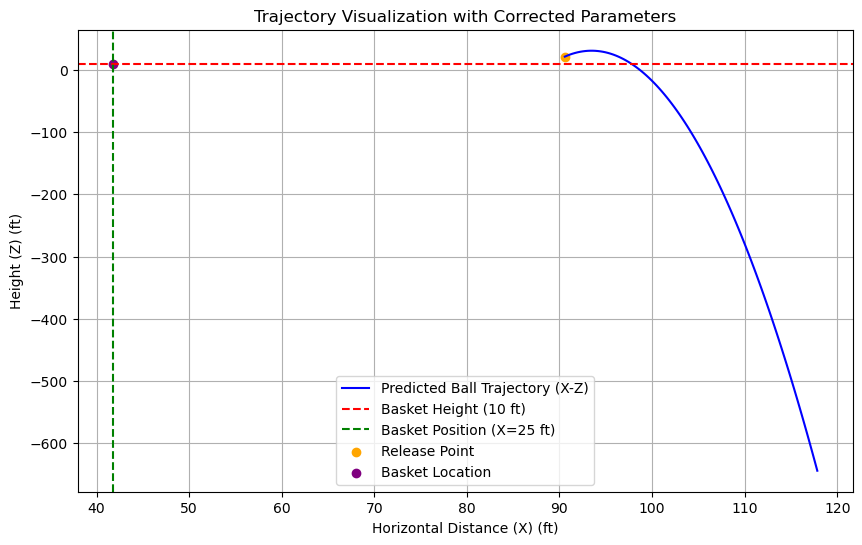

In [18]:
import numpy as np
import matplotlib.pyplot as plt

def predict_trajectory(release_height, ball_velocity_x, ball_velocity_y, ball_velocity_z,
                       release_x, release_y, basket_x, basket_y, basket_z,
                       g=32.174, units='imperial', debug=False, result=None):
    """
    Predict the trajectory of the ball based on initial conditions and validate calculations.

    Parameters:
    - release_height, ball_velocity_x, ball_velocity_y, ball_velocity_z: Initial conditions
    - release_x, release_y: Ball release position
    - basket_x, basket_y, basket_z: Hoop position
    - g: Gravitational acceleration
    - units: 'imperial' for feet, 'metric' for meters
    - debug: Whether to print debug information
    - result: Shot result (e.g., 1 for made, 0 for missed)

    Returns:
    - trajectory: List of (x, y, z) points representing the trajectory
    - predicted_entry_angle: Predicted entry angle of the ball in degrees
    - predicted_landing_x, predicted_landing_y: Predicted landing position
    """
    # Debugging information
    if debug:
        print(f"[DEBUG] Predicting trajectory with hoop position ({basket_x}, {basket_y}, {basket_z})")

    # Step 1: Calculate horizontal velocity magnitude
    v_h = np.sqrt(ball_velocity_x**2 + ball_velocity_y**2)
    if debug:
        print(f"[DEBUG] Horizontal velocity magnitude (v_h): {v_h:.2f} ft/s")

    # Step 2: Calculate horizontal distance to the basket
    distance_to_basket = np.sqrt((basket_x - release_x)**2 + (basket_y - release_y)**2)
    if debug:
        print(f"[DEBUG] Horizontal distance to basket: {distance_to_basket:.2f} ft")

    # Step 3: Calculate time to reach the basket
    t_basket = distance_to_basket / v_h
    if debug:
        print(f"[DEBUG] Time to reach the basket (t_basket): {t_basket:.4f} s")

    # Step 4: Calculate vertical velocity at the basket
    v_z_basket = ball_velocity_z - g * t_basket
    if debug:
        print(f"[DEBUG] Vertical velocity at basket (v_z_basket): {v_z_basket:.2f} ft/s")

    # Step 5: Calculate predicted entry angle
    entry_angle_rad = np.arctan2(-v_z_basket, v_h)
    predicted_entry_angle_deg = np.degrees(entry_angle_rad)
    if debug:
        print(f"[DEBUG] Predicted Entry Angle: {predicted_entry_angle_deg:.2f} degrees")

    # Step 6: Generate trajectory points
    num_points = 100
    trajectory = []
    for t in np.linspace(0, t_basket, num_points):
        x = release_x + ball_velocity_x * t
        y = release_y + ball_velocity_y * t
        z = release_height + ball_velocity_z * t - 0.5 * g * t**2
        trajectory.append((x, y, z))
    
    predicted_landing_x, predicted_landing_y = trajectory[-1][0], trajectory[-1][1]

    # Debugging information
    if debug:
        print(f"[DEBUG] Predicting trajectory with hoop position ({basket_x:.2f}, {basket_y:.2f}, {basket_z:.2f})")
        print(f"Input Parameters:")
        print(f"  Release Height: {release_height:.2f} ft")
        print(f"  Ball Velocity X: {ball_velocity_x:.2f} ft/s")
        print(f"  Ball Velocity Y: {ball_velocity_y:.2f} ft/s")
        print(f"  Ball Velocity Z: {ball_velocity_z:.2f} ft/s")
        print(f"  Release X: {release_x:.2f} ft")
        print(f"  Release Y: {release_y:.2f} ft")
        print(f"  Gravitational Acceleration: {g:.2f} ft/s²")
        
    return trajectory, predicted_entry_angle_deg, predicted_landing_x, predicted_landing_y



def extract_parameters_from_dataset(trial_data, units='imperial', debug=False):
    """
    Extract relevant parameters for trajectory prediction from the trial data.

    Parameters:
    - trial_data: DataFrame containing data for a single trial.
    - units: Unit system of the dataset ('imperial' or 'metric').

    Returns:
    - A dictionary of parameters for trajectory prediction.
    """
    # Identify release frame (first frame with release_point_filter == 1)
    release_frame = trial_data[trial_data['release_point_filter'] == 1].iloc[0]

    # Conversion factors
    m_to_ft = 3.28084  # meters to feet

    # Check if units are metric and convert to imperial if necessary
    if units == 'imperial':
        # Assume positions and velocities are in meters and convert to feet
        conversion_factor = m_to_ft
    else:
        conversion_factor = 1.0

    parameters = {
        'release_height': release_frame['ball_z'] * conversion_factor,  # Height of the ball at release
        'release_z': release_frame['ball_z'] * conversion_factor,       # Z position of the ball at release
        'ball_velocity_x': release_frame['ball_velocity_x'] * conversion_factor,  # Horizontal velocity x
        'ball_velocity_y': release_frame['ball_velocity_y'] * conversion_factor,  # Horizontal velocity y
        'ball_velocity_z': release_frame['ball_velocity_z'] * conversion_factor,  # Vertical velocity
        'release_x': release_frame['ball_x'] * conversion_factor,  # x position at release
        'release_y': release_frame['ball_y'] * conversion_factor,  # y position at release
        'entry_angle': trial_data['entry_angle'].iloc[-1],  # Entry angle at the hoop
        'landing_x': trial_data['landing_x'].iloc[-1] / 12,  # Convert inches to feet
        'landing_y': trial_data['landing_y'].iloc[-1] / 12,  # Convert inches to feet
        'result': trial_data['result'].iloc[0]  # Shot result
    }

    # Add debug output for parameter extraction
    if debug:
        print("[DEBUG] Extracted Parameters:")
        for k, v in parameters.items():
            print(f"  {k}: {v:.2f}")

    return parameters






# Example Usage
reference_df = create_reference_table()
# Column Definitions
column_definitions = get_column_definitions()
print("Column Definitions for the Dataset:\n", column_definitions)

# Validate and predict trajectory for a single trial
trial_id_to_visualize = 'T0088'
trial_data = final_granular_df_with_stats[
    final_granular_df_with_stats['trial_id'] == trial_id_to_visualize
].sort_values(by='frame_time')

# Validate and predict trajectory for a single trial
params = extract_parameters_from_dataset(trial_data)
# Retrieve hoop position
hoop_x, hoop_y, hoop_z = get_hoop_position(court_type='nba', units='ft', debug=True)

# Predict trajectory using corrected parameters
trajectory, predicted_entry_angle, predicted_landing_x, predicted_landing_y = predict_trajectory(
    release_height=params['release_height'],
    ball_velocity_x=params['ball_velocity_x'],
    ball_velocity_y=params['ball_velocity_y'],
    ball_velocity_z=params['ball_velocity_z'],
    release_x=params['release_x'],
    release_y=params['release_y'],
    basket_x=hoop_x,
    basket_y=hoop_y,
    basket_z=hoop_z,
    units='imperial',
    debug=True,
    result=params['result']
)

# Visualize the trajectory
x_vals, y_vals, z_vals = zip(*trajectory)
plt.figure(figsize=(10, 6))
plt.plot(x_vals, z_vals, label="Predicted Ball Trajectory (X-Z)", color='blue')
plt.axhline(hoop_z, color='red', linestyle='--', label="Basket Height (10 ft)")
plt.axvline(hoop_x, color='green', linestyle='--', label="Basket Position (X=25 ft)")
plt.scatter(params['release_x'], params['release_z'], color='orange', label="Release Point")
plt.scatter(hoop_x, hoop_z, color='purple', label="Basket Location")
plt.xlabel("Horizontal Distance (X) (ft)")
plt.ylabel("Height (Z) (ft)")
plt.title("Trajectory Visualization with Corrected Parameters")
plt.legend()
plt.grid()
plt.show()


### Goal: Exhaustion meter
    - do we need the person metrics? height, weight, usual activity to get the typical exhaustion for people or can we get it from this data?

In [19]:


import pandas as pd
import numpy as np

def calculate_continuous_frame_time(df, debug=False):
    """
    Calculates continuous frame time across all trials.
    Resets time for each trial and maintains a cumulative time across all trials.
    """
    if debug:
        print("Step: Calculating continuous frame time...")

    # Ensure the DataFrame is sorted by `trial_id` and `frame_time` for calculations
    df = df.sort_values(by=['trial_id', 'frame_time']).reset_index(drop=True)
    
    # Calculate trial-relative time
    df['by_trial_time'] = df.groupby('trial_id')['frame_time'].transform(lambda x: x - x.min())

    # Add cumulative time across trials
    trial_offsets = df.groupby('trial_id')['by_trial_time'].max().cumsum().shift(fill_value=0)
    df['continuous_frame_time'] = df['by_trial_time'] + df['trial_id'].map(trial_offsets)

    if debug:
        print("Calculated by_trial_time and continuous_frame_time:")
        print(df[['trial_id', 'frame_time', 'by_trial_time', 'continuous_frame_time']].head(10))

    # Validation
    if (df['continuous_frame_time'] < 0).any():
        raise ValueError("Continuous frame time contains negative values.")

    return df


def calculate_energy_metrics(df, power_columns, debug=False):
    """
    Calculates energy metrics for each joint and total energy per frame.
    """
    if debug:
        print("Step: Calculating energy metrics...")
    for power_col in power_columns:
        energy_col = power_col.replace('ongoing_power', 'energy')
        df[energy_col] = df[power_col] * df['dt']
        if debug:
            print(f"Calculated '{energy_col}'. Preview:")
            print(df[[power_col, 'dt', energy_col]].head())

    total_energy_columns = [col.replace('ongoing_power', 'energy') for col in power_columns]
    df['total_energy'] = df[total_energy_columns].sum(axis=1)

    if debug:
        print("Calculated total energy per frame. Preview:")
        print(df[['total_energy']].head())

    return df


def calculate_by_trial_energy(df, energy_columns, debug=False):
    """
    Calculates energy metrics (by-trial and overall) and exhaustion scores.
    """
    if debug:
        print("Step: Calculating by-trial energy and exhaustion scores...")
    # By-trial energy
    df['by_trial_energy'] = df.groupby('trial_id')['total_energy'].cumsum()
    df['by_trial_exhaustion_score'] = (
        df.groupby('trial_id')['by_trial_energy']
        .transform(lambda x: x / x.max())
    )

    # Overall cumulative energy
    df['overall_cumulative_energy'] = df['total_energy'].cumsum()
    max_overall_cumulative_energy = df['overall_cumulative_energy'].max()
    df['overall_exhaustion_score'] = (
        df['overall_cumulative_energy'] / max_overall_cumulative_energy
    )

    if debug:
        print("By-trial energy and exhaustion scores:")
        print(df[['trial_id', 'by_trial_energy', 'by_trial_exhaustion_score']].head())
        print("Overall cumulative energy and exhaustion scores:")
        print(df[['overall_cumulative_energy', 'overall_exhaustion_score']].head())

    return df


def calculate_joint_metrics(df, power_columns, debug=False):
    """
    Calculates per-joint by-trial energy and exhaustion scores.
    """
    if debug:
        print("Step: Calculating per-joint metrics...")
    for power_col in power_columns:
        energy_col = power_col.replace('ongoing_power', 'energy')
        # By-trial energy
        df[f'{energy_col}_by_trial'] = df.groupby('trial_id')[energy_col].cumsum()
        # By-trial exhaustion score
        df[f'{energy_col}_by_trial_exhaustion_score'] = (
            df[f'{energy_col}_by_trial'] /
            df.groupby('trial_id')[f'{energy_col}_by_trial'].transform('max')
        )
        # Overall cumulative energy
        df[f'{energy_col}_overall_cumulative'] = df[energy_col].cumsum()
        # Overall exhaustion score
        df[f'{energy_col}_overall_exhaustion_score'] = (
            df[f'{energy_col}_overall_cumulative'] /
            df[f'{energy_col}_overall_cumulative'].max()
        )
        if debug:
            print(f"Metrics for {energy_col}:")
            print(df[[f'{energy_col}_by_trial', f'{energy_col}_by_trial_exhaustion_score',
                     f'{energy_col}_overall_cumulative', f'{energy_col}_overall_exhaustion_score']].head())
    return df


def validate_metrics(df, power_columns, debug=False):
    """
    Validates the calculated metrics for consistency.
    """
    if debug:
        print("Step: Validating metrics...")

    # Check continuous frame time
    if (df['continuous_frame_time'] < 0).any():
        raise ValueError("Continuous frame time contains negative values.")

    # Validate energy columns
    for power_col in power_columns:
        energy_col = power_col.replace('ongoing_power', 'energy')
        if energy_col not in df.columns:
            raise ValueError(f"Missing energy column: {energy_col}")
        if df[energy_col].isnull().any():
            raise ValueError(f"Energy column {energy_col} contains NaN values.")

    # Validate total energy calculation
    total_energy_columns = [col.replace('ongoing_power', 'energy') for col in power_columns]
    calculated_total_energy = df[total_energy_columns].sum(axis=1)
    if not calculated_total_energy.equals(df['total_energy']):
        raise ValueError("Total energy does not match the sum of individual energy columns.")

    # Validate exhaustion scores
    if not ((df['by_trial_exhaustion_score'] >= 0) & (df['by_trial_exhaustion_score'] <= 1)).all():
        raise ValueError("By-trial exhaustion scores are not normalized between 0 and 1.")
    if not ((df['overall_exhaustion_score'] >= 0) & (df['overall_exhaustion_score'] <= 1)).all():
        raise ValueError("Overall exhaustion scores are not normalized between 0 and 1.")

    if debug:
        print("Validation completed successfully. All metrics are consistent.")
    return True


def main_pipeline(df, power_columns, debug=False):
    """
    Main pipeline to calculate and validate all metrics.
    """
    if debug:
        print("Starting main pipeline...")
    # Step 1: Calculate continuous frame time
    df = calculate_continuous_frame_time(df, debug=debug)
    # Step 2: Calculate energy metrics
    df = calculate_energy_metrics(df, power_columns, debug=debug)
    # Step 3: Calculate by-trial energy and exhaustion scores
    df = calculate_by_trial_energy(df, power_columns, debug=debug)
    # Step 4: Calculate per-joint metrics
    df = calculate_joint_metrics(df, power_columns, debug=debug)
    # Step 5: Validate metrics
    validate_metrics(df, power_columns, debug=debug)

    if debug:
        print("Main pipeline completed successfully.")
    return df


# Example Usage
if __name__ == "__main__":
    # Example DataFrame setup
    print(final_granular_df_with_stats.columns)

    # Expanded list of power columns for all joints
    power_columns = [
        'L_ANKLE_ongoing_power', 'R_ANKLE_ongoing_power',  # Ankles
        'L_KNEE_ongoing_power', 'R_KNEE_ongoing_power',    # Knees
        'L_HIP_ongoing_power', 'R_HIP_ongoing_power',      # Hips
        'L_ELBOW_ongoing_power', 'R_ELBOW_ongoing_power',  # Elbows
        'L_WRIST_ongoing_power', 'R_WRIST_ongoing_power',  # Wrists
        'L_1STFINGER_ongoing_power', 'R_1STFINGER_ongoing_power',  # Index fingers
        'L_5THFINGER_ongoing_power', 'R_5THFINGER_ongoing_power'   # Pinky fingers
    ]

    # Run the pipeline with debug enabled
    processed_df = main_pipeline(final_granular_df_with_stats, power_columns, debug=True)

    # Output processed DataFrame
    print("Processed DataFrame:")
    print(processed_df[['trial_id', 'frame_time', 'by_trial_time', 'continuous_frame_time'
                        ,'L_ANKLE_energy' ,'L_ANKLE_energy_by_trial_exhaustion_score','L_ANKLE_energy_overall_exhaustion_score'
                        ,'L_WRIST_energy_overall_cumulative']].head())



Index(['trial_id', 'result', 'landing_x', 'landing_y', 'entry_angle',
       'frame_time', 'ball_x', 'ball_y', 'ball_z', 'R_EYE_x',
       ...
       'max_wrist_shot_classification', 'max_elbow_shot_classification',
       'max_knee_shot_classification', 'initial_release_angle',
       'calculated_release_angle', 'distance_to_basket',
       'optimal_release_angle', 'initial_ball_release_angle',
       'calculated_ball_release_angle', 'optimal_ball_release_angle'],
      dtype='object', length=170)
Starting main pipeline...
Step: Calculating continuous frame time...
Calculated by_trial_time and continuous_frame_time:
  trial_id  frame_time  by_trial_time  continuous_frame_time
0    T0001        5366              0                      0
1    T0001        5400             34                     34
2    T0001        5433             67                     67
3    T0001        5466            100                    100
4    T0001        5500            134                    134
5    T000

### Checks before ML dataset add on and predictions

In [20]:
import pandas as pd

# Set option to display all columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)

# Print all columns for both DataFrames
print("final_ml_df columns:\n", final_ml_df.columns)
print("final_granular_df columns:\n", processed_df.columns)

final_ml_df_columns = final_ml_df.columns
final_granular_df_with_stats_columns = processed_df.columns
# Create DataFrame with unique columns
unique_columns_df = pd.DataFrame(final_ml_df_columns, columns=['Key Features Unique Columns'])

print(unique_columns_df)

# Create DataFrame with unique columns
granular_unique_columns_df = pd.DataFrame(final_granular_df_with_stats_columns, columns=['Granular Unique Columns'])

print(granular_unique_columns_df)

# Column Definitions
column_definitions = get_column_definitions()
print("Column Definitions for the Dataset:\n", column_definitions)

final_ml_df columns:
 Index(['result', 'landing_x', 'landing_y', 'entry_angle', 'L_ANKLE_min_power',
       'L_ANKLE_max_power', 'L_ANKLE_avg_power', 'L_ANKLE_std_power',
       'R_ANKLE_min_power', 'R_ANKLE_max_power', 'R_ANKLE_avg_power',
       'R_ANKLE_std_power', 'L_KNEE_min_power', 'L_KNEE_max_power',
       'L_KNEE_avg_power', 'L_KNEE_std_power', 'R_KNEE_min_power',
       'R_KNEE_max_power', 'R_KNEE_avg_power', 'R_KNEE_std_power',
       'L_HIP_min_power', 'L_HIP_max_power', 'L_HIP_avg_power',
       'L_HIP_std_power', 'R_HIP_min_power', 'R_HIP_max_power',
       'R_HIP_avg_power', 'R_HIP_std_power', 'L_ELBOW_min_power',
       'L_ELBOW_max_power', 'L_ELBOW_avg_power', 'L_ELBOW_std_power',
       'R_ELBOW_min_power', 'R_ELBOW_max_power', 'R_ELBOW_avg_power',
       'R_ELBOW_std_power', 'L_WRIST_min_power', 'L_WRIST_max_power',
       'L_WRIST_avg_power', 'L_WRIST_std_power', 'R_WRIST_min_power',
       'R_WRIST_max_power', 'R_WRIST_avg_power', 'R_WRIST_std_power',
       'L_1ST

Let's add:
    * summarized by trial exhaustion once checked
      * summarized overall exhaustion and by trial overall exhaustion score at this point
    * distance_to_basket
    * avg_shoulder_height

# ML Dataset Pipeline:
    - definitions/merge into ml dataset
    - multicollinearity/feature importances = feature selection
    - preprocessing suggestions, datasets, preprocessing with strict guidelines
    - ml model selection
    - ml model testing
    - ml data inverse transform
    - ml model prediction
    - live prediction and re-calculate the dataset formulas for when new data attaches
    - get optimal ranges for the angles (knee/wrist/elbow) and input them into the meters
    - input the meters into a video for optimal angles
    - add in ml classification with re-calculation
    - live camera feed with this? 
      - streamlit example of how this works with li


In [21]:
# %%writefile ../../src/freethrow_predictions/ml/ml_definitions.py
# ML Definition and Final ML dataset merge before Preprocessing pipeline


def get_ml_column_definitions():
    """
    Define column descriptions for the ML dataset, including unique key features for predictive modeling.

    Returns:
        column_definitions (dict): Dictionary where keys are column names and values are descriptions.
    """
    column_definitions = {
        # Outcome and trial metadata
        'result': "Binary indicator of shot outcome: 1 if made, 0 if missed.",
        'trial_id': "Unique identifier for each trial, formatted as 'Txxxx'.",
        'shot_id': "Sequential shot ID for organizing shots within a trial.",
        # Add new columns
        'initial_ball_release_angle': "The initially recorded ball release angle based on motion capture.",
        'calculated_ball_release_angle': "Ball release angle computed with adjusted trajectory factors.",
        'distance_to_basket': "Euclidean distance from the ball's release point to the basket plane.",
        'optimal_ball_release_angle': "Theoretical optimal release angle based on shot trajectory models.",
    
        # Landing and entry metrics
        'landing_x': "X coordinate of ball landing position on the hoop plane, measured in inches with the hoop front as origin.",
        'landing_y': "Y coordinate of ball landing position on the hoop plane, measured in inches with the hoop front as origin.",
        'entry_angle': "Angle at which the ball enters the hoop plane, measured in degrees to indicate entry precision.",

        # Joint power metrics (minimum, maximum, average, standard deviation)
        'L_ANKLE_min_power': "Minimum power generated by the left ankle during the motion.",
        'L_ANKLE_max_power': "Maximum power generated by the left ankle during the motion.",
        'L_ANKLE_avg_power': "Average power generated by the left ankle during the motion.",
        'L_ANKLE_std_power': "Standard deviation of the power generated by the left ankle during the motion.",
        'R_ANKLE_min_power': "Minimum power generated by the right ankle during the motion.",
        'R_ANKLE_max_power': "Maximum power generated by the right ankle during the motion.",
        'R_ANKLE_avg_power': "Average power generated by the right ankle during the motion.",
        'R_ANKLE_std_power': "Standard deviation of the power generated by the right ankle during the motion.",
        # Repeat similar definitions for L_KNEE, R_KNEE, L_HIP, R_HIP, L_ELBOW, R_ELBOW, L_WRIST, R_WRIST, L_1STFINGER, L_5THFINGER, R_1STFINGER, R_5THFINGER

        # Joint angles and release angles
        'elbow_max_angle': "Maximum angle achieved by the elbow during the motion.",
        'elbow_release_angle': "Angle of the elbow at the point of ball release.",
        'wrist_max_angle': "Maximum angle achieved by the wrist during the motion.",
        'wrist_release_angle': "Angle of the wrist at the point of ball release.",
        'knee_max_angle': "Maximum angle achieved by the knee during the motion.",
        'knee_release_angle': "Angle of the knee at the point of ball release.",

        # Release ball dynamics
        'release_ball_speed': "Speed of the ball at the point of release, derived from velocity components.",
        'release_ball_velocity_x': "Velocity of the ball along the x-axis at the point of release.",
        'release_ball_velocity_y': "Velocity of the ball along the y-axis at the point of release.",
        'release_ball_velocity_z': "Velocity of the ball along the z-axis at the point of release.",
        'release_ball_direction_x': "Normalized direction of the ball's velocity along the x-axis at the point of release.",
        'release_ball_direction_y': "Normalized direction of the ball's velocity along the y-axis at the point of release.",
        'release_ball_direction_z': "Normalized direction of the ball's velocity along the z-axis at the point of release.",
        'release_ball_x': "X coordinate of the ball's position at the release point.",
        'release_ball_y': "Y coordinate of the ball's position at the release point.",
        'release_ball_z': "Z coordinate of the ball's position (height) at the release point.",
        'release_frame_time': "Frame timestamp at the ball release point, relative to trial start.",
        'release_angle': "Angle of the ball's trajectory at the point of release.",
        'time_to_peak': "Time taken from ball release to the point where the ball reaches its peak height.",
        'peak_height_relative': "Difference between the release height and the peak ball height, representing the shot arc.",

        # Player characteristics
        'player_participant_id': "Unique identifier for the player, used for grouping and analysis.",
        'player_height_in_meters': "Player's height in meters, derived from participant data.",
        'player_weight__in_kg': "Player's weight in kilograms, derived from participant data.",
        'player_dominant_hand': "Player's dominant hand (e.g., 'Left' or 'Right'), based on shooting preference.",
        'player_estimated_wingspan_cm': "Estimated wingspan of the player in centimeters, derived from biometric data.",
        'player_estimated_standing_reach_cm': "Estimated standing reach of the player in centimeters, based on height and arm length.",
        'player_estimated_hand_length_cm': "Estimated hand length of the player in centimeters, derived from biometric data.",
    
        # Joint energy metrics
        'joint_energy': "Energy expended by a specific joint in a single frame, calculated as power multiplied by time delta.",
        'joint_energy_by_trial': "Cumulative energy expended by a specific joint within a trial.",
        'joint_energy_by_trial_exhaustion_score': "Normalized exhaustion score for a specific joint within a trial, scaled to the maximum trial energy.",
        'joint_energy_overall_cumulative': "Cumulative energy expended by a specific joint across all trials.",
        'joint_energy_overall_exhaustion_score': "Normalized exhaustion score for a specific joint across all trials, scaled to the maximum overall energy.",

        # Summarized Energy metrics
        'mean_energy': "Mean energy expended per trial, averaged across all frames.",
        'max_energy': "Maximum energy expended in a single frame during a trial.",
        'mean_exhaustion': "Mean exhaustion score for a trial, averaged across all frames.",
        'max_exhaustion': "Maximum exhaustion score for a trial, representing peak effort.",


    }

    return column_definitions

def summarize_joint_energy_by_trial(processed_df, power_columns, debug=False):
    """
    Summarizes joint energy metrics by trial for inclusion in the ML dataset.

    Args:
        processed_df (DataFrame): Granular dataset containing joint energy metrics.
        power_columns (list): List of joint power columns to process.
        debug (bool): If True, prints debugging information.

    Returns:
        DataFrame: Summary of joint energy metrics by trial.
    """
    if debug:
        print("Summarizing joint energy metrics by trial...")
        print(f"Initial processed_df shape: {processed_df.shape}")

    # Replace power column names with their corresponding energy columns
    energy_columns = [col.replace('ongoing_power', 'energy') for col in power_columns]

    # Validate energy columns exist in processed_df
    missing_columns = [col for col in energy_columns if col not in processed_df.columns]
    if missing_columns:
        raise ValueError(f"Missing energy columns in processed_df: {missing_columns}")

    # Create summarized statistics for each trial
    summary = processed_df.groupby('trial_id')[energy_columns].agg(
        **{f'{col}_mean': (col, 'mean') for col in energy_columns},
        **{f'{col}_max': (col, 'max') for col in energy_columns},
        **{f'{col}_std': (col, 'std') for col in energy_columns}
    ).reset_index()

    if debug:
        print(f"Summary DataFrame shape: {summary.shape}")
        print(f"Number of trials processed: {summary['trial_id'].nunique()}")
        print(f"Columns in summary DataFrame: {summary.columns.tolist()}")

    return summary

def merge_joint_energy_with_ml_dataset(processed_df, final_ml_df, power_columns, debug=False):
    """
    Merges summarized joint energy metrics from the granular dataset into the ML dataset.

    Args:
        processed_df (DataFrame): Granular dataset containing joint energy metrics.
        final_ml_df (DataFrame): Machine learning dataset.
        power_columns (list): List of joint power columns to process.
        debug (bool): If True, prints debugging information.

    Returns:
        DataFrame: Updated ML dataset with joint energy metrics added.
    """
    if debug:
        print("\n[Merging Joint Energy Metrics into ML Dataset]")
        print(f"Shape of processed_df before summarization: {processed_df.shape}")
        print(f"Shape of final_ml_df before merge: {final_ml_df.shape}")

    # Summarize joint energy by trial
    energy_summary = summarize_joint_energy_by_trial(processed_df, power_columns, debug=debug)

    # Identify overlapping columns between final_ml_df and energy_summary (excluding the merge key 'trial_id')
    overlapping_columns = set(final_ml_df.columns).intersection(set(energy_summary.columns)) - {'trial_id'}
    
    if overlapping_columns:
        if debug:
            print(f"Overlapping columns detected: {overlapping_columns}")

        # Rename overlapping columns in energy_summary
        energy_summary = energy_summary.rename(columns={col: f"{col}_summary" for col in overlapping_columns})
        if debug:
            print(f"Renamed overlapping columns in energy_summary: {list(energy_summary.columns)}")

    # Merge the summarized data into the ML dataset with suffixes to handle additional collisions
    try:
        pre_merge_columns = set(final_ml_df.columns)
        final_ml_df = final_ml_df.merge(energy_summary, on='trial_id', how='left', suffixes=('', '_merged'))

        # Check for duplicate columns and resolve them
        duplicated_columns = [col for col in final_ml_df.columns if col.endswith('_merged')]
        if duplicated_columns:
            if debug:
                print(f"Duplicated columns after merge: {duplicated_columns}")
            # Drop duplicated columns or handle them based on preference
            final_ml_df = final_ml_df.drop(columns=duplicated_columns)

        if debug:
            post_merge_columns = set(final_ml_df.columns)
            print(f"Shape of final_ml_df after merge: {final_ml_df.shape}")
            print(f"Columns added during merge: {post_merge_columns - pre_merge_columns}")

    except Exception as e:
        raise RuntimeError(f"Error during merging: {e}")

    return final_ml_df



def validate_joint_energy_in_ml_dataset(final_ml_df, energy_columns, debug=False):
    """
    Validates the presence and correctness of joint energy metrics in the ML dataset.

    Args:
        final_ml_df (DataFrame): Machine learning dataset.
        energy_columns (list): List of energy column names.
        debug (bool): If True, prints validation information.

    Raises:
        ValueError: If any validation checks fail.
    """
    if debug:
        print("Validating joint energy metrics in the ML dataset...")
        print(f"ML dataset shape: {final_ml_df.shape}")
        print(f"Validating {len(energy_columns)} energy columns...")

    # Check for missing columns
    missing_columns = [col for col in energy_columns if col not in final_ml_df.columns]
    if missing_columns:
        raise ValueError(f"Missing energy columns in ML dataset: {missing_columns}")
    if debug:
        print(f"All energy columns present. No missing columns.")

    # Check for NaN values
    nan_columns = [col for col in energy_columns if final_ml_df[col].isnull().any()]
    if nan_columns:
        raise ValueError(f"Energy columns with NaN values: {nan_columns}")
    if debug:
        print("No NaN values detected in energy columns.")

    # Check statistical consistency
    for col in energy_columns:
        if "_max" in col:
            mean_col = col.replace("_max", "_mean")
            if mean_col in final_ml_df.columns:
                inconsistent_rows = final_ml_df[final_ml_df[col] < final_ml_df[mean_col]]
                if not inconsistent_rows.empty:
                    raise ValueError(f"Inconsistent data: {col} has values less than {mean_col}")
    if debug:
        print("All energy columns validated successfully.")

def output_dataset(dataset, filename="final_ml_dataset.csv"):
    """
    Outputs the final dataset to a file and prints a summary.

    Args:
        dataset (pd.DataFrame): The DataFrame to output.
        filename (str): The name of the output file (default: 'final_ml_dataset.csv').
    """
    print("[Step: Outputting Final Dataset]")
    
    # Save the dataset to a CSV file
    dataset.to_csv(filename, index=False)
    print(f"Dataset saved to {filename}")

    # Print a summary of the dataset
    print("Dataset Summary:")
    print(dataset.info())
    print("First few rows of the dataset:")
    print(dataset.head())

if __name__ == "__main__":
    # Example power columns for joints
    power_columns = [
        'L_ANKLE_ongoing_power', 'R_ANKLE_ongoing_power',  # Ankles
        'L_KNEE_ongoing_power', 'R_KNEE_ongoing_power',    # Knees
        'L_HIP_ongoing_power', 'R_HIP_ongoing_power',      # Hips
        'L_ELBOW_ongoing_power', 'R_ELBOW_ongoing_power',  # Elbows
        'L_WRIST_ongoing_power', 'R_WRIST_ongoing_power',  # Wrists
        'L_1STFINGER_ongoing_power', 'R_1STFINGER_ongoing_power',  # Index fingers
        'L_5THFINGER_ongoing_power', 'R_5THFINGER_ongoing_power'   # Pinky fingers
    ]

    # Process granular dataset
    print("[Step: Processing Joint Metrics]")
    processed_df = calculate_joint_metrics(processed_df, power_columns, debug=True)

    # Merge joint energy metrics into ML dataset
    print("[Step: Merging Joint Energy Metrics]")
    final_ml_df = merge_joint_energy_with_ml_dataset(processed_df, final_ml_df, power_columns, debug=True)

    # Define energy columns for validation
    energy_columns = [
        f'{col.replace("ongoing_power", "energy")}_{stat}'
        for col in power_columns for stat in ['mean', 'max', 'std']
    ]

    # Validate the updated ML dataset
    print("[Step: Validating Joint Energy Metrics in ML Dataset]")
    validate_joint_energy_in_ml_dataset(final_ml_df, energy_columns, debug=True)

    # Output column definitions
    print("[Step: Final ML Dataset Column Definitions]")
    column_definitions = get_ml_column_definitions()
    for col, desc in column_definitions.items():
        print(f"{col}: {desc}")

    # Output the dataset to a file
    output_dataset(final_ml_df, filename="../../data/processed/final_ml_dataset.csv")

[Step: Processing Joint Metrics]
Step: Calculating per-joint metrics...
Metrics for L_ANKLE_energy:
   L_ANKLE_energy_by_trial  L_ANKLE_energy_by_trial_exhaustion_score  \
0                 0.003000                                  0.014858   
1                 0.006000                                  0.029717   
2                 0.011196                                  0.055452   
3                 0.016196                                  0.080216   
4                 0.021295                                  0.105471   

   L_ANKLE_energy_overall_cumulative  L_ANKLE_energy_overall_exhaustion_score  
0                           0.003000                                 0.000087  
1                           0.006000                                 0.000175  
2                           0.011196                                 0.000326  
3                           0.016196                                 0.000472  
4                           0.021295                               